## This notebook is modified from
https://www.kaggle.com/hmendonca/proper-clustering-with-facenet-embeddings-eda

In [1]:
import os
import glob
import torch
import cv2
from PIL import Image
import numpy as np
import pandas as pd
from pathlib import Path
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm as tqdm
import json
import seaborn as sns

with open("../user_config.json") as config:
    js = json.load(config)
    emb_path = js['data_paths']['facenet_embeddings']
    face_path = js['data_paths']['large_faces']
print("Embeddings: " + emb_path)

Embeddings: /mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/face_embeddings_2


In [2]:
# Get all embedding paths
filenames = []
for filename in Path(emb_path).rglob('*0.npy'):
    filenames.append(filename)
filenames_second_person = []
for filename in Path(emb_path).rglob('*1.npy'):
    filenames_second_person.append(filename)
print(len(filenames), len(filenames_second_person))

118598 114749


In [3]:
# Get all face paths
image_filenames = []
for image_filename in Path(face_path).rglob('*0_0.jpg'):
    image_filenames.append(image_filename)
image_filenames_second_person = []
for image_filename in Path(face_path).rglob('*1_0.jpg'):
    image_filenames_second_person.append(image_filename)
print(len(image_filenames),len(image_filenames_second_person))

118176 15443


In [4]:
def getFilepath(fn):
    for f in image_filenames:
        if fn in str(f):
            return str(f)
    return None

getFilepath('djbimbpwbg')

'/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_faces_2/djbimbpwbg_0_0.jpg'

## Read only original faces

We will only perform clustering on the originals and later add fakes to the same clusters as their originals. 

In [5]:
df = pd.read_csv('../data/metadata_tr_val_split.csv')
df = df[df['original'].isnull()]
print(len(df))
df.head()

19154


,index,label,split,original,isVal,person_count
67,bmrwcqrpyp.mp4,REAL,train,NaN,False,0
78,jkdehoarcj.mp4,REAL,train,NaN,False,1
82,aywpqylxdm.mp4,REAL,train,NaN,False,0
98,nvirvscqzx.mp4,REAL,train,NaN,False,1
115,sjtuoasekc.mp4,REAL,train,NaN,False,0


In [6]:
videonames = df['index'].values

In [7]:
missing_image_path = '../materials/missing_image_placeholder.png'
cv2.imwrite(missing_image_path, np.zeros((299,299,3)))

True

In [8]:
emb_list = []
face_paths = []
new_videonames = []
for vname in tqdm(videonames):
    _id = vname.replace('.mp4','')
    new_videonames.append(vname)
    emb0_pth = os.path.join(emb_path,_id + '_0.npy')
    emb1_pth = os.path.join(emb_path,_id + '_1.npy')
    img0_pth = os.path.join(face_path,_id + '_0_0.png')
    img1_pth = os.path.join(face_path,_id + '_1_0.png')
    
    def isValidEmbedding(emb_path):
        if os.path.isfile(emb_path):
            if np.load(emb_path).shape[0] > 0:
                return True
        return False
    
    if isValidEmbedding(emb0_pth):
        emb = np.load(emb0_pth).mean(axis=0)
        emb_list.append(emb.tolist())
    else:
        emb_list.append(None)
    
    if os.path.isfile(img0_pth):
        face_paths.append(img0_pth)
    else:
        face_paths.append(None)
        
    #second face
    if isValidEmbedding(emb1_pth):
        emb = np.load(emb1_pth).mean(axis=0)
        emb_list.append(emb.tolist())
        new_videonames.append(vname + '__2__')
        if os.path.isfile(img1_pth):
            face_paths.append(img1_pth)
        else:
            face_paths.append(None)
            
df = pd.DataFrame({'video':new_videonames,'face': face_paths,'embedding': emb_list})
df = df.dropna()
print(len(df))
df.head()


21073


,video,face,embedding
0,bmrwcqrpyp.mp4,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[0.014415252022445202, -0.007140998728573322, ..."
1,jkdehoarcj.mp4,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[-0.01891389675438404, 0.037828486412763596, -..."
3,nvirvscqzx.mp4,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[-0.0010092161828652024, 0.03164698928594589, ..."
4,nvirvscqzx.mp4__2__,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[0.011313372291624546, 0.04632732644677162, 0...."
5,sjtuoasekc.mp4,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[-0.0017034972552210093, -0.012684030458331108..."


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21073 entries, 0 to 21127
Data columns (total 3 columns):
video        21073 non-null object
face         21073 non-null object
embedding    21073 non-null object
dtypes: object(3)
memory usage: 658.5+ KB


In [10]:
df.to_csv('../tmp/video_embeddings_originals.csv',index=False)

### Checkpoint

In [11]:
df = pd.read_csv('../tmp/video_embeddings_originals.csv')
df.head()

,video,face,embedding
0,bmrwcqrpyp.mp4,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[0.014415252022445202, -0.007140998728573322, ..."
1,jkdehoarcj.mp4,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[-0.01891389675438404, 0.037828486412763596, -..."
2,nvirvscqzx.mp4,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[-0.0010092161828652024, 0.03164698928594589, ..."
3,nvirvscqzx.mp4__2__,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[0.011313372291624546, 0.04632732644677162, 0...."
4,sjtuoasekc.mp4,/mnt/945C2D6E5C2D4BF4/Kaggle/DeepFake/large_fa...,"[-0.0017034972552210093, -0.012684030458331108..."


# PCA

In [12]:
from sklearn.decomposition import PCA
data = [np.array(dt.replace('[','').replace(']','').split(',')).astype(np.float) for dt in df['embedding']]

In [4]:
np.isnan(data).any()

False

In [13]:
def scatter_thumbnails(data, images, zoom=0.10, colors=None):
    assert len(data) == len(images)

    # reduce embedding dimentions to 2
    x = PCA(n_components=2).fit_transform(data) #if len(data[0]) > 2 else data

    # create a scatter plot.
    f = plt.figure(figsize=(22, 15))
    ax = plt.subplot(aspect='equal')
    sc = ax.scatter(x[:,0], x[:,1], s=4)
    _ = ax.axis('off')
    _ = ax.axis('tight')

    # add thumbnails :)
    from matplotlib.offsetbox import OffsetImage, AnnotationBbox
    for i in range(len(images)):
        image = plt.imread(images[i].replace('large','small'))
        im = OffsetImage(image, zoom=zoom)
        bboxprops = dict(edgecolor=colors[i]) if colors is not None else None
        ab = AnnotationBbox(im, x[i], xycoords='data',
                            frameon=(bboxprops is not None),
                            pad=0.02,
                            bboxprops=bboxprops)
        ax.add_artist(ab)
    return ax

In [ ]:
_ = scatter_thumbnails(data, df.face.tolist())
plt.title('Facial Embeddings - Principal Component Analysis')
plt.show()

In [ ]:
import gc
gc.collect()

## t-SNE

In [14]:
from sklearn.manifold import TSNE

In [15]:
%%time

# PCA first to speed it up
x = PCA(n_components=50).fit_transform(data)#df['embedding'].tolist())
x = TSNE(perplexity=50,
         n_components=3).fit_transform(x)

CPU times: user 10min 12s, sys: 2.66 s, total: 10min 15s
Wall time: 9min 48s


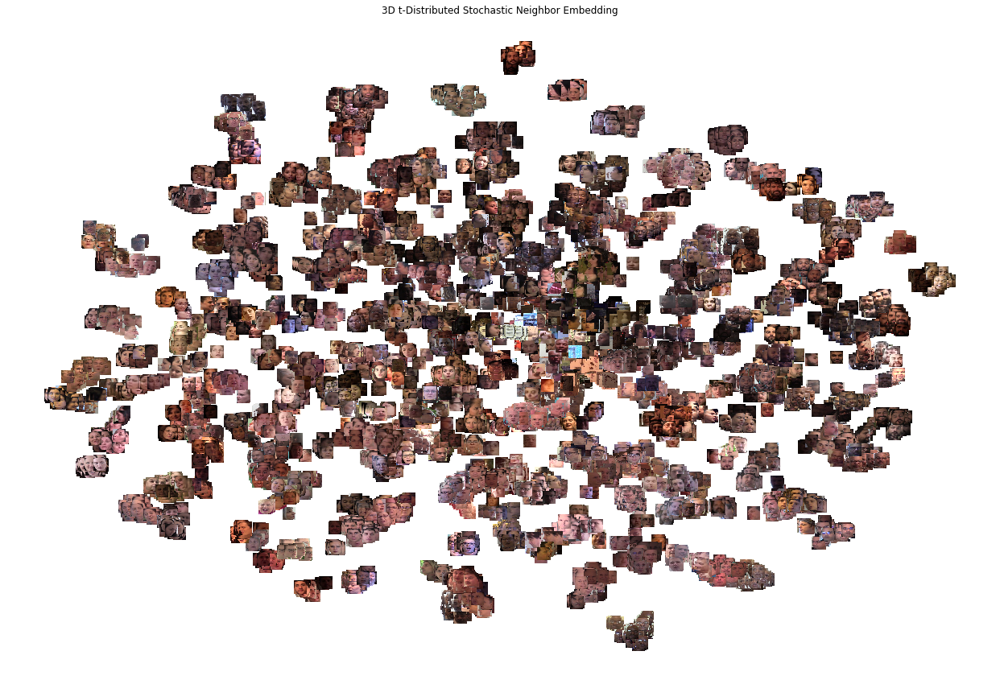

In [16]:
_ = scatter_thumbnails(x, df.face.tolist(), zoom=0.10)
plt.title('3D t-Distributed Stochastic Neighbor Embedding')
plt.show()

In [17]:
np.save('../data/tsne_clusters.npy',x)

## DBSCAN

In [18]:
x = np.load('../data/tsne_clusters.npy')

In [19]:
import sklearn.cluster as cluster

In [20]:
def plot_clusters(data, algorithm, *args, **kwds):
    labels = algorithm(*args, **kwds).fit_predict(data)
    palette = sns.color_palette('deep', np.max(labels) + 1)
    colors = [palette[x] if x >= 0 else (0,0,0) for x in labels]
    ax = scatter_thumbnails(x, df.face.tolist(), 0.06, colors)
    plt.title(f'Clusters found by {algorithm.__name__}')
    return labels

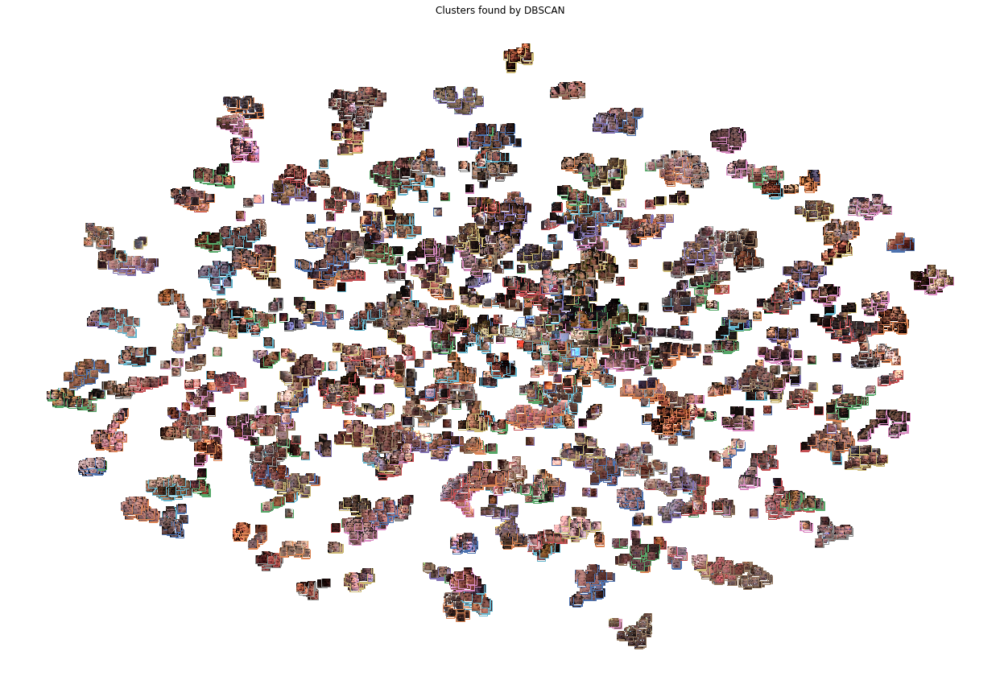

In [21]:
# clusters = plot_clusters(x, hdbscan.HDBSCAN, alpha=1.0, min_cluster_size=2, min_samples=1)
clusters = plot_clusters(x, cluster.DBSCAN, n_jobs=-1, eps=1.0, min_samples=1)
df['cluster'] = clusters

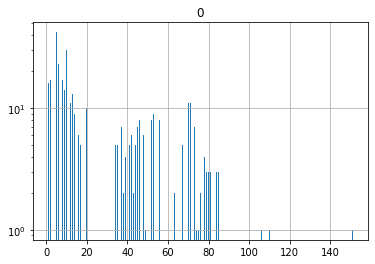

In [22]:
# clusters and the number of images on each one of them
ids, counts = np.unique(clusters, return_counts=True)
_ = pd.DataFrame(counts, index=ids).hist(bins=len(ids), log=True)

In [23]:
df.to_csv('../tmp/video_embeddings_originals.csv',index=False)

### Get similar faces

In [24]:
from annoy import AnnoyIndex

f = len(data[0])
t = AnnoyIndex(f, metric='euclidean')
ntree = 50

for i, vector in enumerate(data):
    t.add_item(i, vector)
_  = t.build(ntree)

In [25]:
def get_similar_images_annoy(img_index, n=8, max_dist=1.0):
    vid, face  = df.iloc[img_index, [0, 1]]
    similar_img_ids, dist = t.get_nns_by_item(img_index, n+1, include_distances=True)
    similar_img_ids = [s for s,d in zip(similar_img_ids, dist) if d <= max_dist][1:]  # first item is always its own video
    return vid, face, df.iloc[similar_img_ids], dist

In [26]:
def get_sample_n_similar(sample_idx):
    vid, face, similar, distances = get_similar_images_annoy(sample_idx)
    
    fig = plt.figure(figsize=(15, 7))
    gs = fig.add_gridspec(2, 6)
    ax1 = fig.add_subplot(gs[0:2, 0:2])
    ax2 = fig.add_subplot(gs[0, 2])
    ax3 = fig.add_subplot(gs[0, 3])
    ax4 = fig.add_subplot(gs[0, 4])
    ax5 = fig.add_subplot(gs[0, 5])
    ax6 = fig.add_subplot(gs[1, 2])
    ax7 = fig.add_subplot(gs[1, 3])
    ax8 = fig.add_subplot(gs[1, 4])
    ax9 = fig.add_subplot(gs[1, 5])
    axx = [ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9]
    for ax in axx:
        ax.set_axis_off()
    list_plot = [face] + similar['face'].values.tolist()
    list_cluster = [df.iloc[sample_idx]['cluster']] + similar['cluster'].values.tolist()
    for ax, face, cluster, dist in zip(axx, list_plot, list_cluster, distances):
        ax.imshow(plt.imread(face))
        ax.set_title(f'{face.split("/")[-1][:-8]}, Dist:{dist:.2f}\nCluster:{cluster}') # show video filename and distance


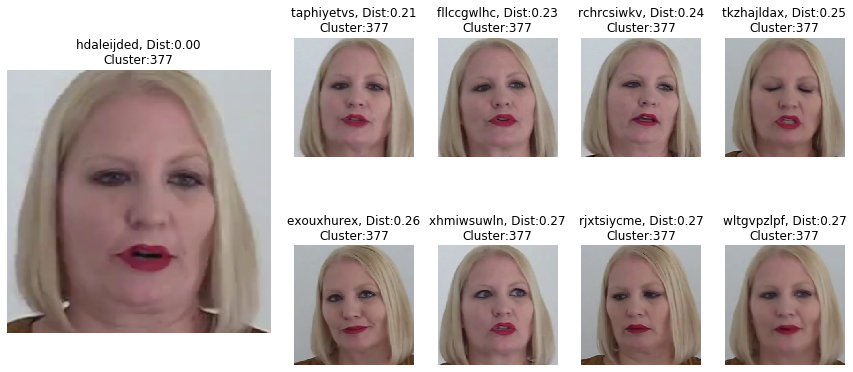

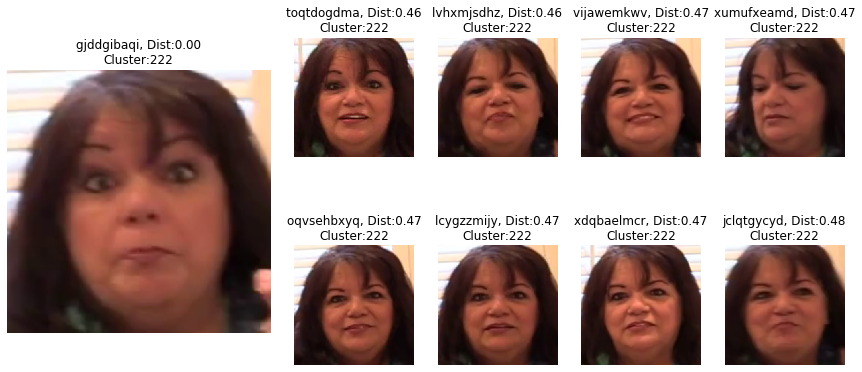

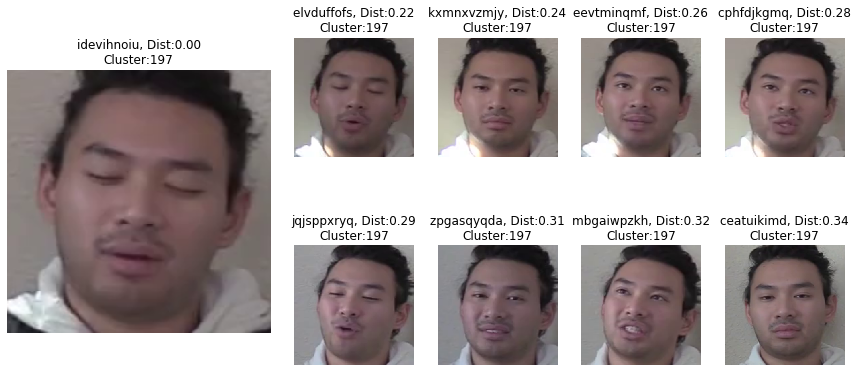

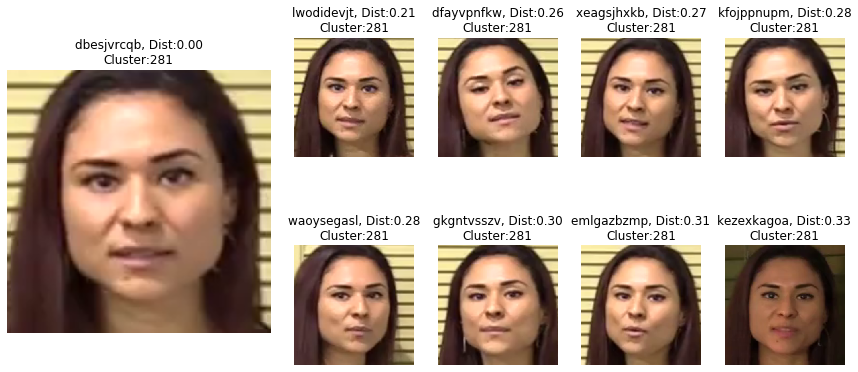

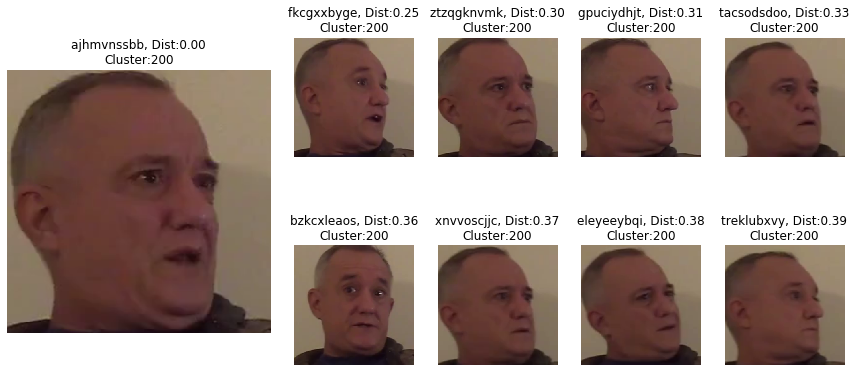

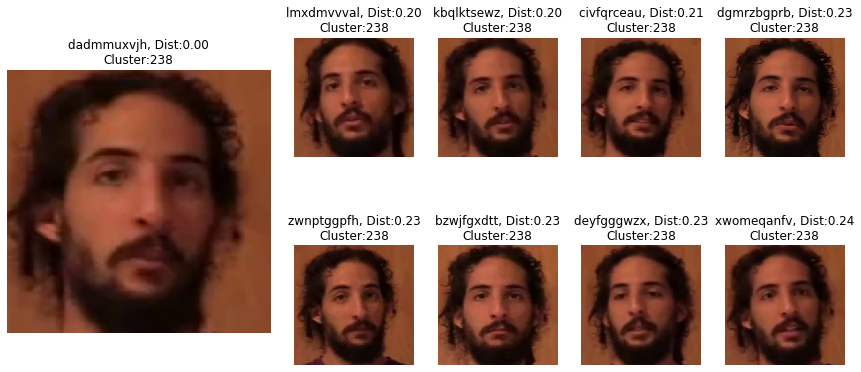

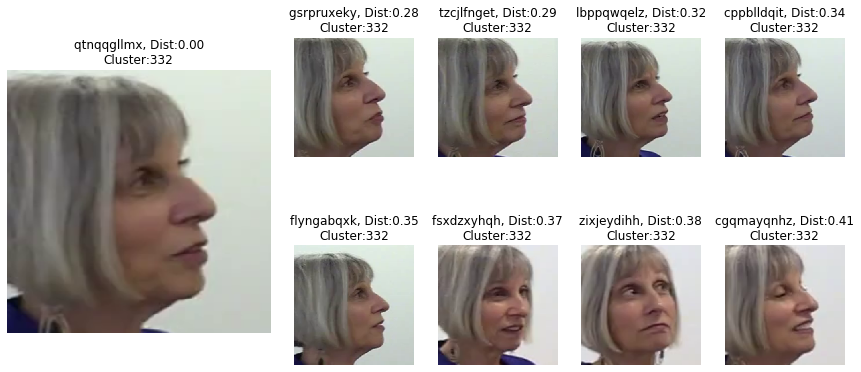

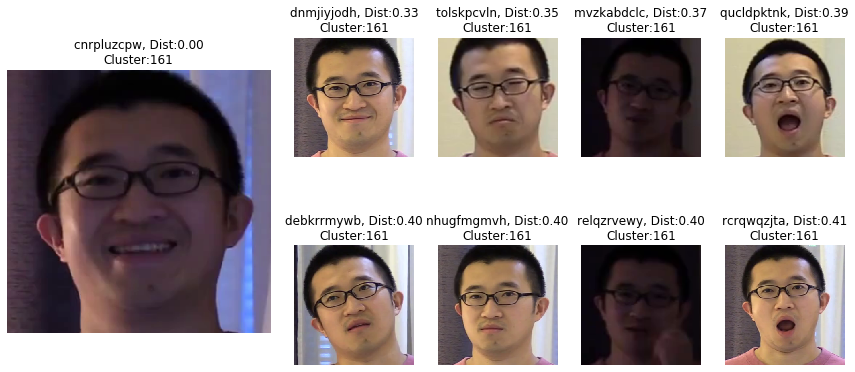

In [27]:
# display samples and their nearest neighbors
for i in np.random.choice(len(df), 8, replace=False):
    get_sample_n_similar(i)

In [28]:
df_clusters = df[['video','cluster']]
df_clusters.head()

,video,cluster
0,bmrwcqrpyp.mp4,0
1,jkdehoarcj.mp4,0
2,nvirvscqzx.mp4,1
3,nvirvscqzx.mp4__2__,0
4,sjtuoasekc.mp4,0


In [29]:
df_clusters.to_csv('../data/face_clusters2.csv', index=False)

Combine clusters that appear in the same video.

In [30]:
new_clusters_1 = []
new_clusters_2 = []
combined_cluster_dict = {}
for vname in tqdm(videonames):
    clus = df_clusters[df_clusters['video'].str.contains(vname)].cluster.values
    if clus.shape[0]==0:
        new_clusters_1.append(None)
        new_clusters_2.append(None)
    elif clus.shape[0]==1:
        new_clusters_1.append(clus[0])
        new_clusters_2.append(None)
    else:
        new_clusters_1.append(clus[0])
        new_clusters_2.append(clus[1])

In [31]:
df_combined_clusters = pd.DataFrame({'video':videonames, 'cluster_1': new_clusters_1, 'cluster_2':new_clusters_2})
df_combined_clusters.head()

,video,cluster_1,cluster_2
0,bmrwcqrpyp.mp4,0.0,NaN
1,jkdehoarcj.mp4,0.0,NaN
2,aywpqylxdm.mp4,NaN,NaN
3,nvirvscqzx.mp4,1.0,0.0
4,sjtuoasekc.mp4,0.0,NaN


In [32]:
df_combined_clusters.to_csv('../data/face_clusters_combined.csv', index=False)

What clusters appear together?

In [33]:
df_two_clusters = df_combined_clusters.dropna()
df_two_clusters['both'] = [str(cl1)+'-'+str(cl2) for cl1,cl2 in zip(df_two_clusters['cluster_1'].values,
                                                      df_two_clusters['cluster_2'].values)]
np.unique(df_two_clusters.both.values)

/home/joni/.local/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


array(['0.0-1.0', '0.0-2.0', '1.0-0.0', '101.0-97.0', '103.0-104.0',
       '105.0-55.0', '106.0-107.0', '106.0-108.0', '107.0-106.0',
       '108.0-106.0', '109.0-79.0', '11.0-524.0', '11.0-571.0',
       '11.0-8.0', '112.0-114.0', '114.0-112.0', '115.0-2.0',
       '116.0-55.0', '116.0-79.0', '12.0-13.0', '124.0-125.0',
       '124.0-126.0', '126.0-124.0', '13.0-12.0', '130.0-131.0',
       '130.0-30.0', '132.0-133.0', '133.0-132.0', '137.0-138.0',
       '137.0-139.0', '138.0-137.0', '14.0-15.0', '141.0-142.0',
       '142.0-247.0', '142.0-339.0', '142.0-503.0', '142.0-628.0',
       '144.0-145.0', '144.0-2.0', '145.0-144.0', '147.0-33.0',
       '148.0-53.0', '149.0-150.0', '149.0-410.0', '152.0-153.0',
       '153.0-152.0', '154.0-155.0', '156.0-55.0', '161.0-2.0',
       '165.0-166.0', '165.0-167.0', '167.0-165.0', '17.0-18.0',
       '17.0-19.0', '171.0-172.0', '174.0-175.0', '175.0-174.0',
       '175.0-176.0', '175.0-224.0', '175.0-289.0', '175.0-497.0',
       '175.0-556.0', 

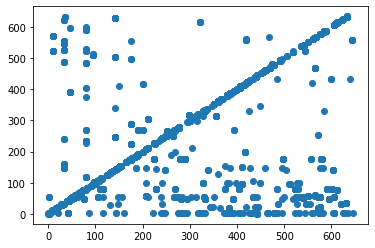

In [34]:
import matplotlib.pyplot as plt
plt.scatter(df_two_clusters.cluster_1.values,df_two_clusters.cluster_2.values)

## Check that there are no leaks in the current train/val split

In [6]:
df = pd.read_csv('../data/metadata_tr_val_split_folds.csv')
df.head()

,index,label,split,isVal,cv_fold,person_count,original,version
0,gmuagvvcen.mp4,FAKE,2nd_level,True,4,1,xyioxposka.mp4,2020-01-28
1,nlbejgudfx.mp4,FAKE,1st_level,False,1,1,acguxjvmju.mp4,2020-01-28
2,smptxlklxc.mp4,REAL,1st_level,False,2,1,NaN,2020-01-28
3,xmodyeeaxr.mp4,FAKE,1st_level,False,1,1,ptpwappdyx.mp4,2020-01-28
4,hvxrsfgvyi.mp4,FAKE,1st_level,False,2,2,qelncdmypn.mp4,2020-01-28


In [8]:
unique_clusters = np.unique(df_clusters.cluster.values)

Check that no cluster has items in more than one fold and either in train or val split.

Fold leaks in cluster 0. Example: xdmvimchwx.mp4 is in 1 and kpkbtvsxlz.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 1. nvirvscqzx.mp4 is in 1st_level and vtqlkmvbid.mp4 is in 2nd_level


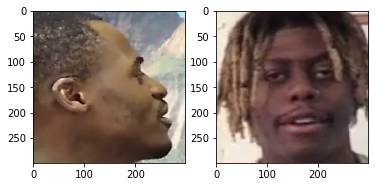

Fold leaks in cluster 1. Example: vtqlkmvbid.mp4 is in 1 and nvirvscqzx.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 2. vyuvcsjiwn.mp4 is in 1st_level and efjgycrwfm.mp4 is in 2nd_level


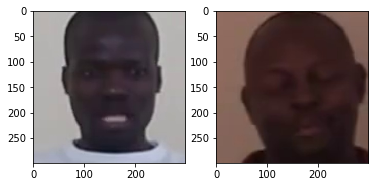

Fold leaks in cluster 2. Example: efjgycrwfm.mp4 is in 2 and vyuvcsjiwn.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 3. oisiyudtkv.mp4 is in 1st_level and xuvjbhkfqu.mp4 is in 2nd_level


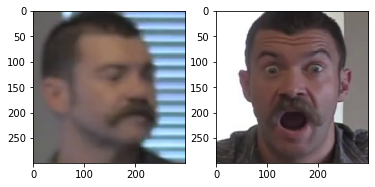

Fold leaks in cluster 3. Example: oisiyudtkv.mp4 is in 2 and oizgennqfn.mp4 is in 3
Fold leaks in cluster 5. Example: kgckxrwwut.mp4 is in 2 and jnohdhinec.mp4 is in 3
Fold leaks in cluster 8. Example: sgwfxrzzjm.mp4 is in 2 and ndmzxmfjkf.mp4 is in 4
Fold leaks in cluster 9. Example: fakbxbxxjy.mp4 is in 0 and fqpuryhmnj.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 10. zubufjhlcd.mp4 is in 1st_level and cuqpcymavt.mp4 is in 2nd_level


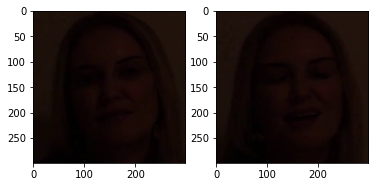

Fold leaks in cluster 10. Example: cuqpcymavt.mp4 is in 2 and zubufjhlcd.mp4 is in 3
!!! 16 TRAIN-VAL LEAK(s) in cluster 11. ypkehhhckj.mp4 is in 1st_level and lpfmqnxogg.mp4 is in 2nd_level


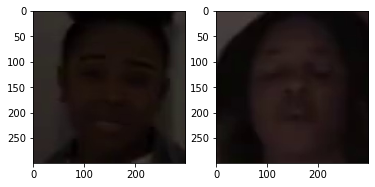

Fold leaks in cluster 11. Example: lqkqtmahyv.mp4 is in 0 and tgulamvlno.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 12. grezcjcqqg.mp4 is in 1st_level and tcrtqlfiag.mp4 is in 2nd_level


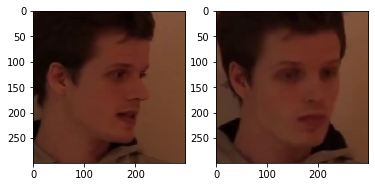

Fold leaks in cluster 12. Example: tcrtqlfiag.mp4 is in 0 and grezcjcqqg.mp4 is in 2
!!! 9 TRAIN-VAL LEAK(s) in cluster 13. difjncqlff.mp4 is in 1st_level and lpmqtgsran.mp4 is in 2nd_level


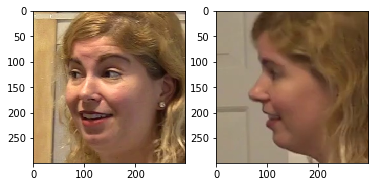

Fold leaks in cluster 13. Example: difjncqlff.mp4 is in 0 and qidxyekgyv.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 14. kwtwgpknir.mp4 is in 1st_level and urynqxxkxx.mp4 is in 2nd_level


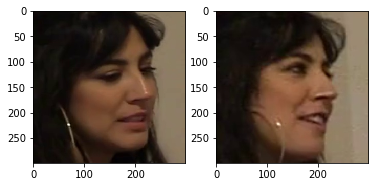

Fold leaks in cluster 14. Example: kwtwgpknir.mp4 is in 2 and urynqxxkxx.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 15. bpuztimwat.mp4 is in 1st_level and spvwlyhjil.mp4 is in 2nd_level


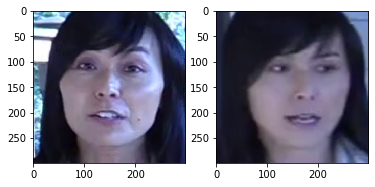

Fold leaks in cluster 15. Example: hqyvmzekuy.mp4 is in 0 and bpuztimwat.mp4 is in 1
!!! 8 TRAIN-VAL LEAK(s) in cluster 17. xkfliqnmwt.mp4 is in 1st_level and hsbwhlolsn.mp4 is in 2nd_level


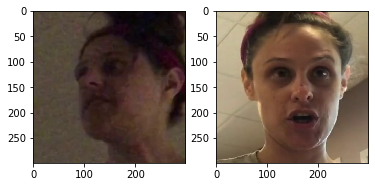

Fold leaks in cluster 17. Example: pqdeutauqc.mp4 is in 1 and hsbwhlolsn.mp4 is in 3
Fold leaks in cluster 18. Example: qarqtkvgby.mp4 is in 2 and qyqufaskjs.mp4 is in 3
!!! 29 TRAIN-VAL LEAK(s) in cluster 19. blszgmxkvu.mp4 is in 1st_level and viteugozpv.mp4 is in 2nd_level


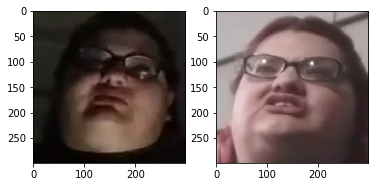

Fold leaks in cluster 19. Example: blszgmxkvu.mp4 is in 0 and ywauoonmlr.mp4 is in 1
!!! 4 TRAIN-VAL LEAK(s) in cluster 21. comqkwjrft.mp4 is in 1st_level and weluahjayz.mp4 is in 2nd_level


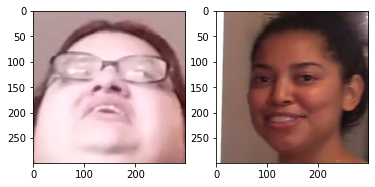

Fold leaks in cluster 21. Example: comqkwjrft.mp4 is in 0 and ycgyjqlygh.mp4 is in 2
Fold leaks in cluster 22. Example: obozirvzxd.mp4 is in 0 and nzbgohmaja.mp4 is in 1
!!! 4 TRAIN-VAL LEAK(s) in cluster 25. bfjsthfhbd.mp4 is in 1st_level and zmxeiipnqb.mp4 is in 2nd_level


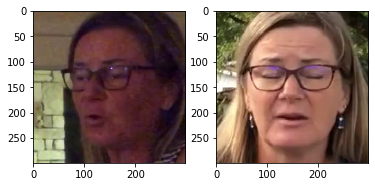

Fold leaks in cluster 25. Example: bfjsthfhbd.mp4 is in 0 and xzkikmghps.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 26. ypgayhhaxx.mp4 is in 1st_level and dcfodaqazt.mp4 is in 2nd_level


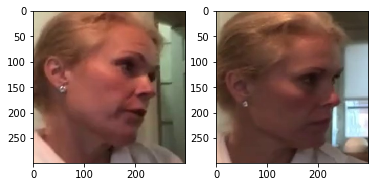

Fold leaks in cluster 26. Example: fhjhvdgmcq.mp4 is in 2 and dcfodaqazt.mp4 is in 3
Fold leaks in cluster 28. Example: xpivslxbup.mp4 is in 0 and chohzofpsz.mp4 is in 1
Fold leaks in cluster 29. Example: ihglzxzroo.mp4 is in 0 and rmlzgerevr.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 30. adohdulfwb.mp4 is in 1st_level and rlqbowounu.mp4 is in 2nd_level


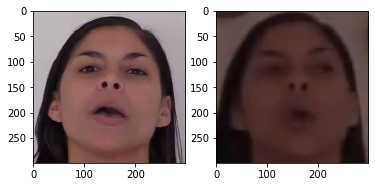

Fold leaks in cluster 30. Example: rlqbowounu.mp4 is in 0 and gfgcwxkbjd.mp4 is in 2
Fold leaks in cluster 32. Example: mrgmchwvfk.mp4 is in 2 and spzmqugvtn.mp4 is in 3
!!! 6 TRAIN-VAL LEAK(s) in cluster 33. mcchrddyxx.mp4 is in 1st_level and iumybqkbzt.mp4 is in 2nd_level


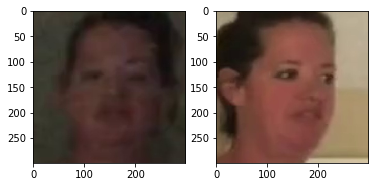

Fold leaks in cluster 33. Example: iumybqkbzt.mp4 is in 2 and mcchrddyxx.mp4 is in 3
!!! 8 TRAIN-VAL LEAK(s) in cluster 35. goegdmmyxk.mp4 is in 1st_level and yvkuususfu.mp4 is in 2nd_level


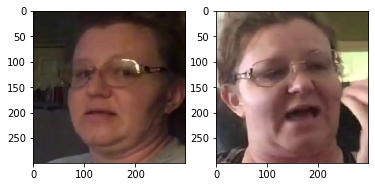

Fold leaks in cluster 35. Example: goegdmmyxk.mp4 is in 0 and yvkuususfu.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 36. kmktfamvoi.mp4 is in 1st_level and pnzjahgfcj.mp4 is in 2nd_level


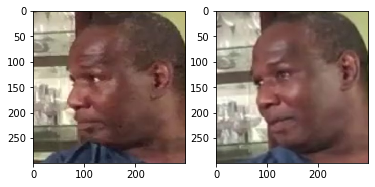

Fold leaks in cluster 36. Example: kmktfamvoi.mp4 is in 0 and pnzjahgfcj.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 41. bcbrujsqxo.mp4 is in 1st_level and ucorvldjhi.mp4 is in 2nd_level


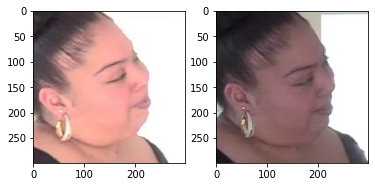

Fold leaks in cluster 41. Example: ucorvldjhi.mp4 is in 0 and jqiayxomia.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 43. omodwoqqhv.mp4 is in 1st_level and ddrcabjbza.mp4 is in 2nd_level


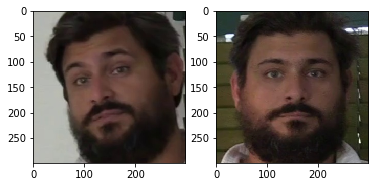

Fold leaks in cluster 43. Example: omodwoqqhv.mp4 is in 0 and ebuebnxpdq.mp4 is in 2
!!! 7 TRAIN-VAL LEAK(s) in cluster 44. bltrrevthi.mp4 is in 1st_level and hslupphtel.mp4 is in 2nd_level


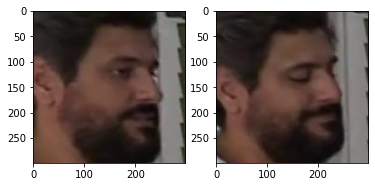

Fold leaks in cluster 44. Example: bltrrevthi.mp4 is in 2 and zwrulgwqve.mp4 is in 3
!!! 4 TRAIN-VAL LEAK(s) in cluster 45. tlqapqqspa.mp4 is in 1st_level and xptdonvkbv.mp4 is in 2nd_level


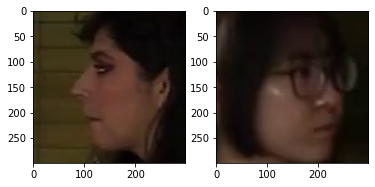

Fold leaks in cluster 45. Example: ksfgswbvck.mp4 is in 1 and tlqapqqspa.mp4 is in 2
Fold leaks in cluster 46. Example: ilvmgunkie.mp4 is in 1 and ueqbcbqpep.mp4 is in 3
!!! 3 TRAIN-VAL LEAK(s) in cluster 48. jkxrjgnksq.mp4 is in 1st_level and qethauxnwk.mp4 is in 2nd_level


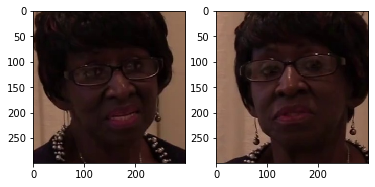

Fold leaks in cluster 48. Example: qethauxnwk.mp4 is in 2 and hgqqwuqrlm.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 49. rdmyllnaxb.mp4 is in 1st_level and pbfeaioghf.mp4 is in 2nd_level


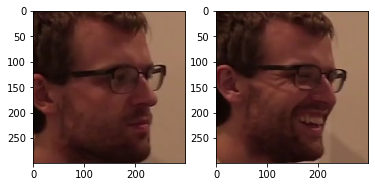

Fold leaks in cluster 49. Example: rdmyllnaxb.mp4 is in 2 and pbfeaioghf.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 50. nbrbwqrwnb.mp4 is in 1st_level and ifvbwbcnyj.mp4 is in 2nd_level


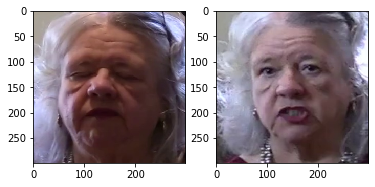

Fold leaks in cluster 50. Example: shehvyhzsd.mp4 is in 2 and ifvbwbcnyj.mp4 is in 4
Fold leaks in cluster 51. Example: jlzckbmrbw.mp4 is in 2 and gnhbtnojfp.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 54. awjizuuwtg.mp4 is in 1st_level and nxipnkaszw.mp4 is in 2nd_level


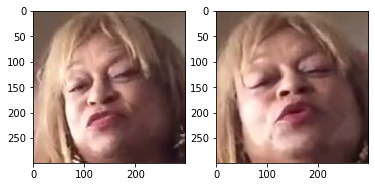

Fold leaks in cluster 54. Example: awjizuuwtg.mp4 is in 1 and nxipnkaszw.mp4 is in 4
!!! 5 TRAIN-VAL LEAK(s) in cluster 55. fhhpgvcqoh.mp4 is in 1st_level and jbdmfjnsup.mp4 is in 2nd_level


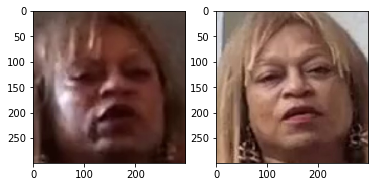

Fold leaks in cluster 55. Example: fhhpgvcqoh.mp4 is in 1 and jbdmfjnsup.mp4 is in 4
!!! 15 TRAIN-VAL LEAK(s) in cluster 56. ldjtsczhoc.mp4 is in 1st_level and hwlizlhzjj.mp4 is in 2nd_level


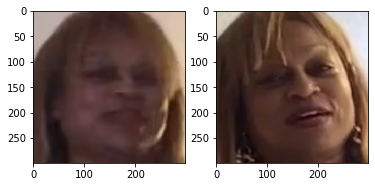

Fold leaks in cluster 56. Example: ruhrdhrxud.mp4 is in 0 and cawpdvymcp.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 58. vqjlmpdhge.mp4 is in 1st_level and trzrrqxqwl.mp4 is in 2nd_level


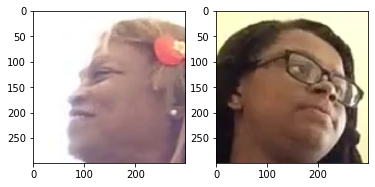

!!! 1 TRAIN-VAL LEAK(s) in cluster 59. rqjzgviqwd.mp4 is in 1st_level and krgdrnmezx.mp4 is in 2nd_level


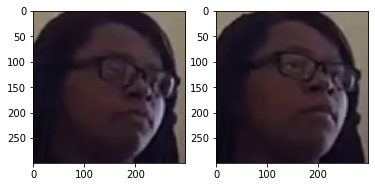

Fold leaks in cluster 59. Example: kzlgbrclpb.mp4 is in 1 and krgdrnmezx.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 60. xylxjtdsdq.mp4 is in 1st_level and ercgpntrbr.mp4 is in 2nd_level


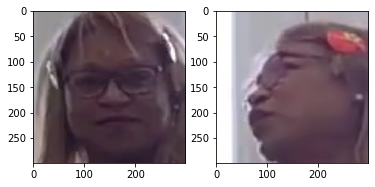

Fold leaks in cluster 60. Example: xylxjtdsdq.mp4 is in 1 and ercgpntrbr.mp4 is in 2
!!! 5 TRAIN-VAL LEAK(s) in cluster 61. xrdopedqcu.mp4 is in 1st_level and olqshoikjs.mp4 is in 2nd_level


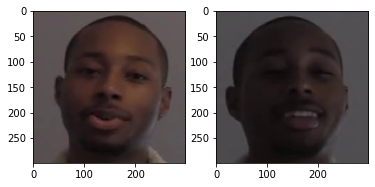

Fold leaks in cluster 61. Example: olqshoikjs.mp4 is in 1 and pwvnzblmuf.mp4 is in 2
Fold leaks in cluster 64. Example: azcbnczesb.mp4 is in 0 and qrbpkxbaeh.mp4 is in 2
Fold leaks in cluster 65. Example: xrnrtmxfad.mp4 is in 0 and kyitsyzrme.mp4 is in 4
!!! 13 TRAIN-VAL LEAK(s) in cluster 66. cgmcrovuwg.mp4 is in 1st_level and mnsnxzfofw.mp4 is in 2nd_level


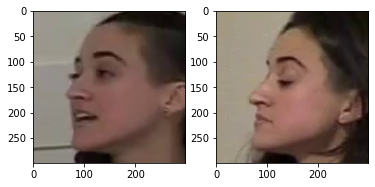

Fold leaks in cluster 66. Example: cfiujbglvp.mp4 is in 0 and lobyiumwce.mp4 is in 1
!!! 3 TRAIN-VAL LEAK(s) in cluster 67. bryxfrlkul.mp4 is in 1st_level and qotqjzqlnr.mp4 is in 2nd_level


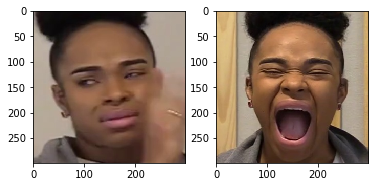

Fold leaks in cluster 67. Example: qotqjzqlnr.mp4 is in 1 and lbnagdkozn.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 73. xeiywpkzlq.mp4 is in 1st_level and cnigvwpbnp.mp4 is in 2nd_level


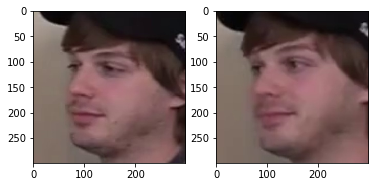

Fold leaks in cluster 73. Example: xeiywpkzlq.mp4 is in 2 and cnigvwpbnp.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 74. zqpvuvftex.mp4 is in 1st_level and etfpaxveba.mp4 is in 2nd_level


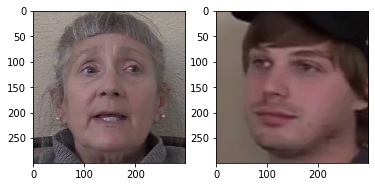

Fold leaks in cluster 74. Example: zqpvuvftex.mp4 is in 2 and etfpaxveba.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 75. tvdtyyckmf.mp4 is in 1st_level and unuqkggkib.mp4 is in 2nd_level


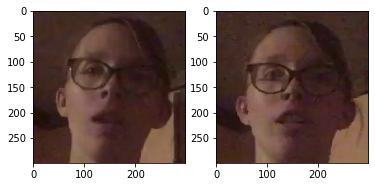

Fold leaks in cluster 75. Example: crrihgnehr.mp4 is in 1 and unuqkggkib.mp4 is in 2
Fold leaks in cluster 79. Example: rqriuezjkz.mp4 is in 1 and iiwlglequh.mp4 is in 2
Fold leaks in cluster 80. Example: zwxmakbntx.mp4 is in 1 and mavitcblnh.mp4 is in 3
!!! 4 TRAIN-VAL LEAK(s) in cluster 82. stylanuirx.mp4 is in 1st_level and zvwfzkeygq.mp4 is in 2nd_level


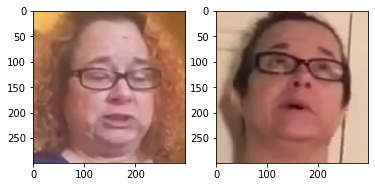

Fold leaks in cluster 82. Example: skmibjwozz.mp4 is in 0 and stylanuirx.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 83. stysfprtdg.mp4 is in 1st_level and wvccagxjni.mp4 is in 2nd_level


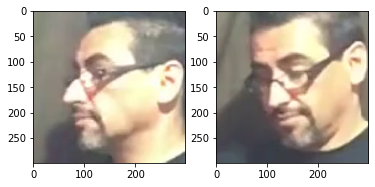

Fold leaks in cluster 83. Example: rrublvorxr.mp4 is in 2 and wvccagxjni.mp4 is in 3
Fold leaks in cluster 84. Example: ulqckpzekt.mp4 is in 1 and dpcnkzulmt.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 86. jgjllbodby.mp4 is in 1st_level and sfbzqkseyn.mp4 is in 2nd_level


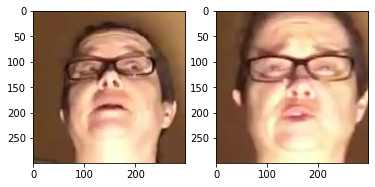

Fold leaks in cluster 86. Example: gggxkzqtvh.mp4 is in 1 and jgjllbodby.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 87. lvnjzrvzwy.mp4 is in 1st_level and pfjmkrdbay.mp4 is in 2nd_level


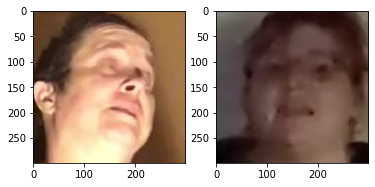

Fold leaks in cluster 87. Example: dgagwsjkqk.mp4 is in 1 and lvnjzrvzwy.mp4 is in 2
Fold leaks in cluster 91. Example: darxemfscl.mp4 is in 0 and ybqmttnept.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 92. jjmthqeecu.mp4 is in 1st_level and wfzgksqequ.mp4 is in 2nd_level


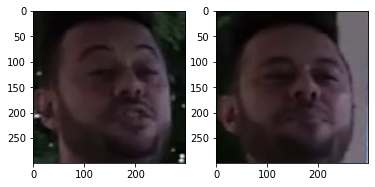

Fold leaks in cluster 92. Example: wfzgksqequ.mp4 is in 2 and jjmthqeecu.mp4 is in 4
Fold leaks in cluster 93. Example: eawmxkambo.mp4 is in 0 and qnbxhdufkr.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 95. arqemexeyx.mp4 is in 1st_level and hkoxvelxxh.mp4 is in 2nd_level


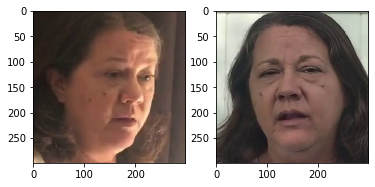

Fold leaks in cluster 95. Example: arqemexeyx.mp4 is in 0 and qttjycrjpk.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 96. huowsesgyq.mp4 is in 1st_level and tkofwngclr.mp4 is in 2nd_level


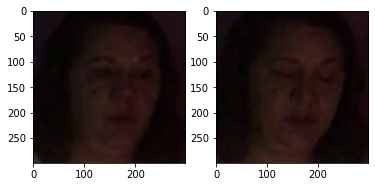

Fold leaks in cluster 96. Example: tkofwngclr.mp4 is in 2 and huowsesgyq.mp4 is in 3
Fold leaks in cluster 97. Example: ilmssrcmcm.mp4 is in 1 and bsnrcykrki.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 98. yflzmdpkab.mp4 is in 1st_level and olrulxguui.mp4 is in 2nd_level


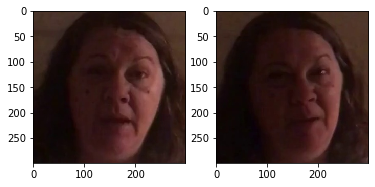

Fold leaks in cluster 98. Example: yflzmdpkab.mp4 is in 0 and olrulxguui.mp4 is in 3
Fold leaks in cluster 103. Example: mfhqonawni.mp4 is in 0 and nnjmbcmolg.mp4 is in 1
Fold leaks in cluster 106. Example: obvbmbynuy.mp4 is in 1 and kwqdmpmiok.mp4 is in 2
!!! 4 TRAIN-VAL LEAK(s) in cluster 107. ddhijrstzr.mp4 is in 1st_level and hjzwbsmiam.mp4 is in 2nd_level


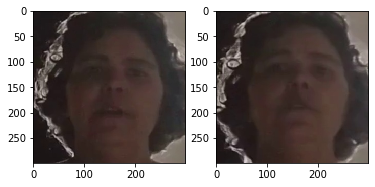

Fold leaks in cluster 107. Example: ddhijrstzr.mp4 is in 0 and hjzwbsmiam.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 108. slkmlgxvqg.mp4 is in 1st_level and dhtwqllwch.mp4 is in 2nd_level


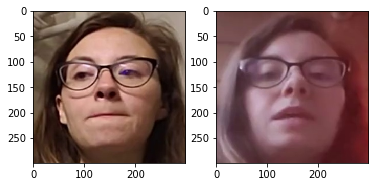

Fold leaks in cluster 108. Example: slkmlgxvqg.mp4 is in 1 and lgxesvqirp.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 110. tbgllketip.mp4 is in 1st_level and bglsrppmtk.mp4 is in 2nd_level


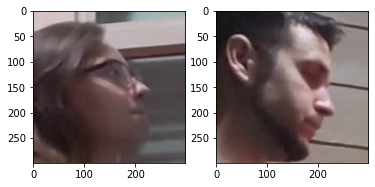

Fold leaks in cluster 110. Example: bglsrppmtk.mp4 is in 0 and tbgllketip.mp4 is in 2
Fold leaks in cluster 111. Example: mlqtepcdhs.mp4 is in 1 and nauoqhhash.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 112. jfbnkogfbq.mp4 is in 1st_level and icjdxrzrwp.mp4 is in 2nd_level


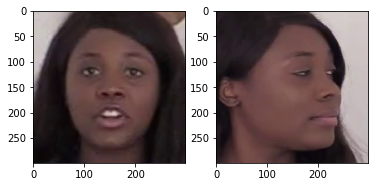

Fold leaks in cluster 112. Example: jfbnkogfbq.mp4 is in 2 and cfayaairkq.mp4 is in 3
!!! 21 TRAIN-VAL LEAK(s) in cluster 114. hzfozlzdnz.mp4 is in 1st_level and chjhbsexls.mp4 is in 2nd_level


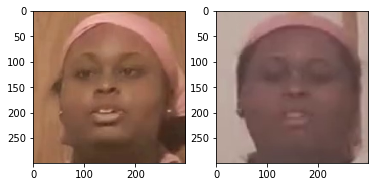

Fold leaks in cluster 114. Example: hzfozlzdnz.mp4 is in 0 and chjhbsexls.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 115. zmmdjdpjra.mp4 is in 1st_level and gjgqtllwqz.mp4 is in 2nd_level


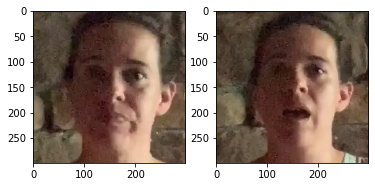

Fold leaks in cluster 115. Example: pgyrbuytsb.mp4 is in 1 and jhtafcntss.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 116. amzfqufrpe.mp4 is in 1st_level and octcsyucti.mp4 is in 2nd_level


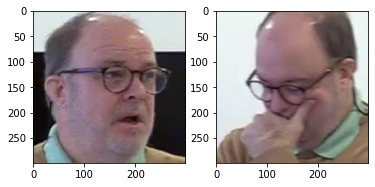

Fold leaks in cluster 116. Example: qsiydsugmm.mp4 is in 0 and jyvlalljen.mp4 is in 1
Fold leaks in cluster 117. Example: cvotzhernt.mp4 is in 0 and titlyyrfyv.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 120. ztbinwxgyu.mp4 is in 1st_level and uaxoybuwem.mp4 is in 2nd_level


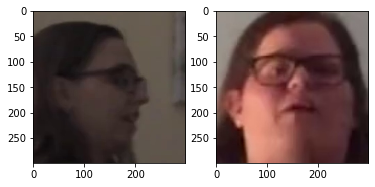

Fold leaks in cluster 120. Example: uaxoybuwem.mp4 is in 1 and rlvgtsjyer.mp4 is in 2
!!! 7 TRAIN-VAL LEAK(s) in cluster 121. pwugzqrzqu.mp4 is in 1st_level and ojmzinvfgy.mp4 is in 2nd_level


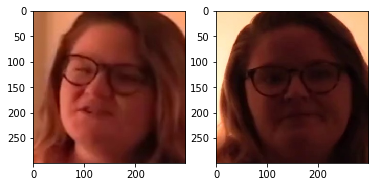

Fold leaks in cluster 121. Example: pwugzqrzqu.mp4 is in 0 and hkjnztvsmk.mp4 is in 1
!!! 5 TRAIN-VAL LEAK(s) in cluster 123. zpykipigtu.mp4 is in 1st_level and bjzkahdzig.mp4 is in 2nd_level


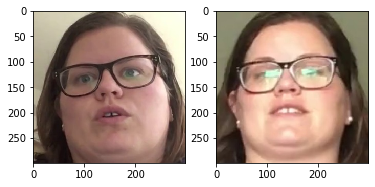

Fold leaks in cluster 123. Example: bjzkahdzig.mp4 is in 1 and zpykipigtu.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 124. rmcuoghsmr.mp4 is in 1st_level and osaqfchczp.mp4 is in 2nd_level


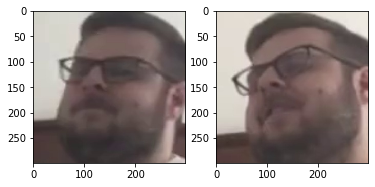

Fold leaks in cluster 124. Example: rmcuoghsmr.mp4 is in 0 and osaqfchczp.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 125. jgvxopxppa.mp4 is in 1st_level and laxoxhpnbu.mp4 is in 2nd_level


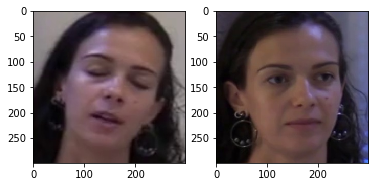

Fold leaks in cluster 125. Example: jgvxopxppa.mp4 is in 0 and laxoxhpnbu.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 126. xnojggkrxt.mp4 is in 1st_level and zyqphtqdii.mp4 is in 2nd_level


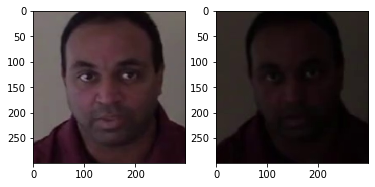

Fold leaks in cluster 126. Example: zyqphtqdii.mp4 is in 2 and huilufzozs.mp4 is in 3
Fold leaks in cluster 127. Example: nddepqnpvd.mp4 is in 2 and nzycclllqm.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 128. jyvrnyjaaa.mp4 is in 1st_level and utyrstessb.mp4 is in 2nd_level


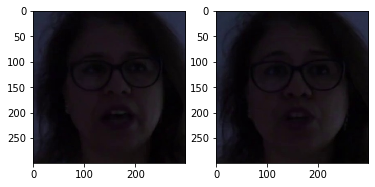

Fold leaks in cluster 128. Example: jyvrnyjaaa.mp4 is in 1 and utyrstessb.mp4 is in 2
Fold leaks in cluster 129. Example: aqlwusgzbf.mp4 is in 1 and stzkqbnqbc.mp4 is in 3
Fold leaks in cluster 131. Example: feeaepqihl.mp4 is in 3 and dipshxxebt.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 132. fwdoyacnai.mp4 is in 1st_level and hpumfhgpxr.mp4 is in 2nd_level


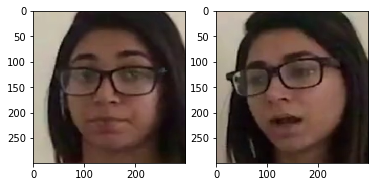

Fold leaks in cluster 132. Example: fwdoyacnai.mp4 is in 0 and hpumfhgpxr.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 133. rnckeghtyz.mp4 is in 1st_level and defrnleigv.mp4 is in 2nd_level


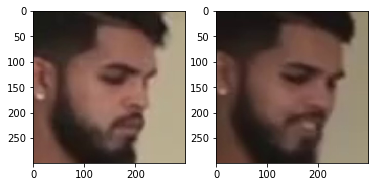

Fold leaks in cluster 134. Example: agvfchxufj.mp4 is in 1 and vmckfdrklb.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 136. svqelqfbhv.mp4 is in 1st_level and qftxfwzudq.mp4 is in 2nd_level


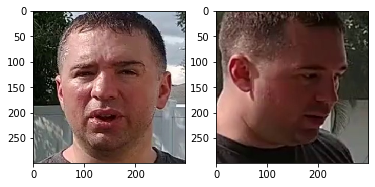

Fold leaks in cluster 136. Example: qftxfwzudq.mp4 is in 2 and svqelqfbhv.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 137. ogbhknawmi.mp4 is in 1st_level and tdugcuamwt.mp4 is in 2nd_level


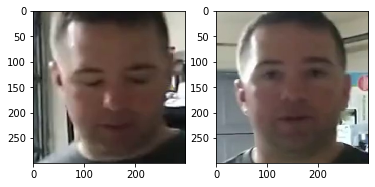

Fold leaks in cluster 137. Example: jcirgymcmp.mp4 is in 2 and ogbhknawmi.mp4 is in 3
!!! 9 TRAIN-VAL LEAK(s) in cluster 139. cdtakhdhdb.mp4 is in 1st_level and qqzfztcrif.mp4 is in 2nd_level


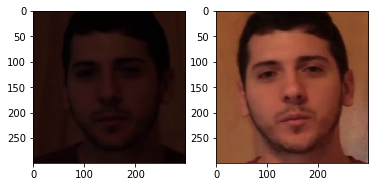

Fold leaks in cluster 139. Example: pnvkzhgusd.mp4 is in 2 and cdtakhdhdb.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 140. pxzwyhbznd.mp4 is in 1st_level and hobblmkges.mp4 is in 2nd_level


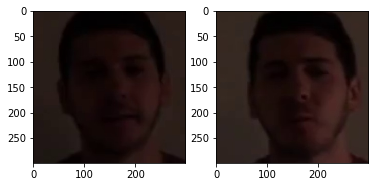

Fold leaks in cluster 140. Example: hobblmkges.mp4 is in 3 and pxzwyhbznd.mp4 is in 4
!!! 10 TRAIN-VAL LEAK(s) in cluster 143. clvbctyrsn.mp4 is in 1st_level and wfgupxdioe.mp4 is in 2nd_level


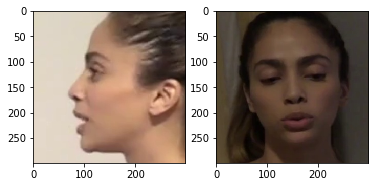

Fold leaks in cluster 143. Example: zeekakenpt.mp4 is in 0 and clvbctyrsn.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 144. ahsuwsrgrw.mp4 is in 1st_level and xtzbukvobk.mp4 is in 2nd_level


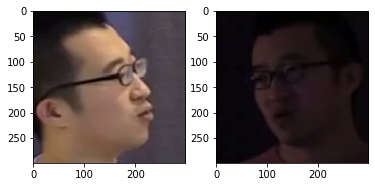

Fold leaks in cluster 144. Example: fivwyuyndg.mp4 is in 0 and ahsuwsrgrw.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 145. ghpnfodcij.mp4 is in 1st_level and mbsnwahcij.mp4 is in 2nd_level


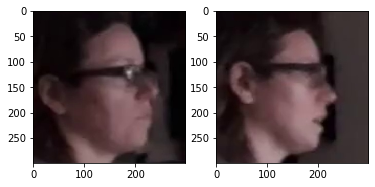

Fold leaks in cluster 145. Example: mbsnwahcij.mp4 is in 1 and ghpnfodcij.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 147. onyecbzgmi.mp4 is in 1st_level and kqulsjxhro.mp4 is in 2nd_level


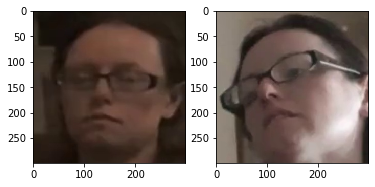

Fold leaks in cluster 147. Example: kqulsjxhro.mp4 is in 1 and zovvcyafzh.mp4 is in 4
!!! 2 TRAIN-VAL LEAK(s) in cluster 148. fwzjvfcdji.mp4 is in 1st_level and iawyhyvobd.mp4 is in 2nd_level


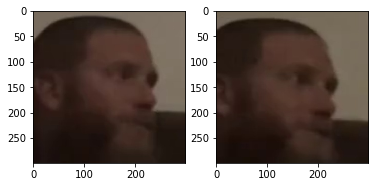

Fold leaks in cluster 148. Example: fwzjvfcdji.mp4 is in 1 and iawyhyvobd.mp4 is in 2
Fold leaks in cluster 152. Example: hrwnzlqruf.mp4 is in 2 and yvojjqtrju.mp4 is in 3
Fold leaks in cluster 154. Example: eqxlbewrge.mp4 is in 0 and mhfdamnmpw.mp4 is in 1
Fold leaks in cluster 156. Example: nhwpcxkwfv.mp4 is in 0 and kvslzyjejv.mp4 is in 2
Fold leaks in cluster 157. Example: ndiztmdymo.mp4 is in 0 and tfmwmmtpgj.mp4 is in 2
Fold leaks in cluster 162. Example: vmybacvzdx.mp4 is in 2 and mskudsvpmn.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 164. fkflfsklrg.mp4 is in 1st_level and lihvznfdxy.mp4 is in 2nd_level


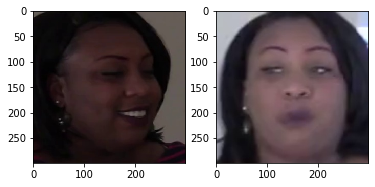

Fold leaks in cluster 164. Example: xmjmtxpmho.mp4 is in 1 and lihvznfdxy.mp4 is in 3
!!! 4 TRAIN-VAL LEAK(s) in cluster 165. ykysqrbthc.mp4 is in 1st_level and ekonqkcioi.mp4 is in 2nd_level


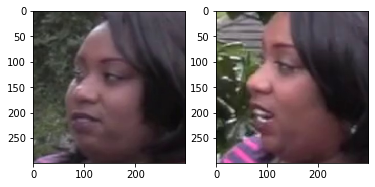

Fold leaks in cluster 165. Example: ykysqrbthc.mp4 is in 0 and ekonqkcioi.mp4 is in 3
!!! 3 TRAIN-VAL LEAK(s) in cluster 166. dtijcohbrd.mp4 is in 1st_level and thvnmktzgq.mp4 is in 2nd_level


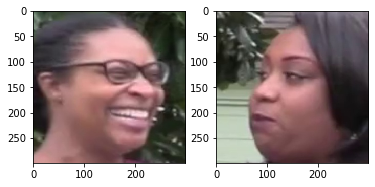

Fold leaks in cluster 166. Example: dtijcohbrd.mp4 is in 0 and thvnmktzgq.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 167. ciqgwitsga.mp4 is in 1st_level and xniuxdhzew.mp4 is in 2nd_level


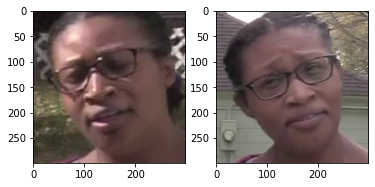

Fold leaks in cluster 167. Example: ciqgwitsga.mp4 is in 1 and xniuxdhzew.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 168. ybwjcpognh.mp4 is in 1st_level and vbjajngdsk.mp4 is in 2nd_level


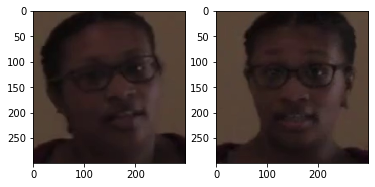

Fold leaks in cluster 168. Example: ybwjcpognh.mp4 is in 1 and vbjajngdsk.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 169. mtaezkotwl.mp4 is in 1st_level and huowmqotqo.mp4 is in 2nd_level


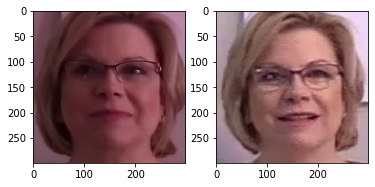

Fold leaks in cluster 169. Example: mtaezkotwl.mp4 is in 0 and huowmqotqo.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 170. dprtqyvvca.mp4 is in 1st_level and cjxypalpdm.mp4 is in 2nd_level


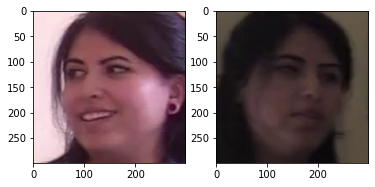

Fold leaks in cluster 170. Example: cjxypalpdm.mp4 is in 2 and dprtqyvvca.mp4 is in 4
Fold leaks in cluster 171. Example: xfdjdsvdoq.mp4 is in 1 and xtklrqzbov.mp4 is in 2
Fold leaks in cluster 176. Example: bwbgomtfhd.mp4 is in 1 and ipvjznvcjj.mp4 is in 4
Fold leaks in cluster 177. Example: rqpdpfewfi.mp4 is in 1 and ztzqgknvmk.mp4 is in 2
!!! 4 TRAIN-VAL LEAK(s) in cluster 179. zyoajdecdm.mp4 is in 1st_level and fssfmkvkci.mp4 is in 2nd_level


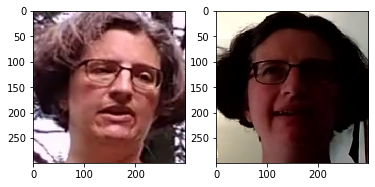

Fold leaks in cluster 179. Example: zyoajdecdm.mp4 is in 0 and fssfmkvkci.mp4 is in 1
Fold leaks in cluster 181. Example: vciegnusjr.mp4 is in 3 and sxmditukrr.mp4 is in 4
!!! 5 TRAIN-VAL LEAK(s) in cluster 183. xvaacqjaso.mp4 is in 1st_level and mtghshmpkq.mp4 is in 2nd_level


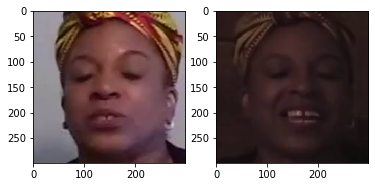

Fold leaks in cluster 183. Example: xvaacqjaso.mp4 is in 0 and mtghshmpkq.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 188. crgcccsirc.mp4 is in 1st_level and zvbmbhrgbu.mp4 is in 2nd_level


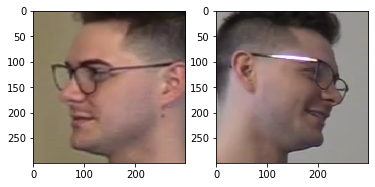

Fold leaks in cluster 188. Example: zvbmbhrgbu.mp4 is in 1 and crgcccsirc.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 189. jswsssnhzq.mp4 is in 1st_level and dmcvlfcjfq.mp4 is in 2nd_level


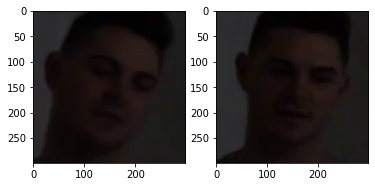

Fold leaks in cluster 189. Example: dmcvlfcjfq.mp4 is in 2 and jswsssnhzq.mp4 is in 4
!!! 4 TRAIN-VAL LEAK(s) in cluster 193. cvaaaorptd.mp4 is in 1st_level and vgkffuboll.mp4 is in 2nd_level


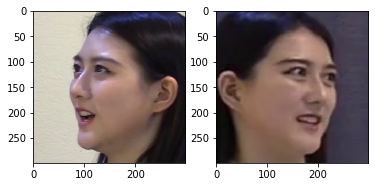

Fold leaks in cluster 196. Example: xxtbukztkx.mp4 is in 1 and ictnvgvaem.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 198. yhjrxkrtpz.mp4 is in 1st_level and ipowmecrzs.mp4 is in 2nd_level


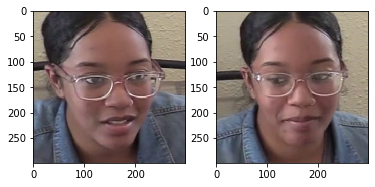

Fold leaks in cluster 198. Example: yhjrxkrtpz.mp4 is in 0 and ipowmecrzs.mp4 is in 2
Fold leaks in cluster 200. Example: jlflzghftl.mp4 is in 0 and qjgiutecmv.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 202. pmtfvfuhkh.mp4 is in 1st_level and zqfsdlgkvx.mp4 is in 2nd_level


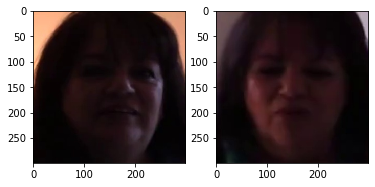

Fold leaks in cluster 202. Example: zqfsdlgkvx.mp4 is in 0 and pmtfvfuhkh.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 204. dhtfrptgwk.mp4 is in 1st_level and uvuahskwrx.mp4 is in 2nd_level


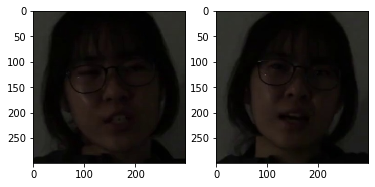

Fold leaks in cluster 204. Example: dhtfrptgwk.mp4 is in 2 and uvuahskwrx.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 206. mwfyzcznjm.mp4 is in 1st_level and wqsltapewl.mp4 is in 2nd_level


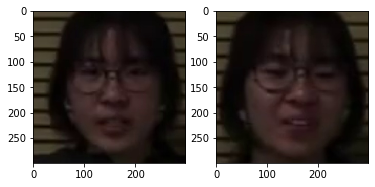

Fold leaks in cluster 206. Example: mwfyzcznjm.mp4 is in 0 and wqsltapewl.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 208. nzwwlrlahm.mp4 is in 1st_level and pzgjlhmtva.mp4 is in 2nd_level


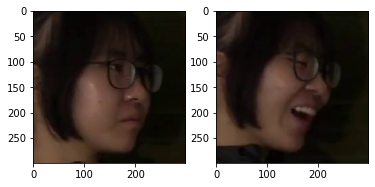

Fold leaks in cluster 208. Example: nzwwlrlahm.mp4 is in 2 and pzgjlhmtva.mp4 is in 3
!!! 3 TRAIN-VAL LEAK(s) in cluster 211. mvnmdxgsfm.mp4 is in 1st_level and moezhyyudz.mp4 is in 2nd_level


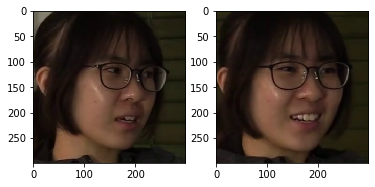

Fold leaks in cluster 211. Example: mvnmdxgsfm.mp4 is in 2 and moezhyyudz.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 212. nlsqkoisdk.mp4 is in 1st_level and nxketuekxm.mp4 is in 2nd_level


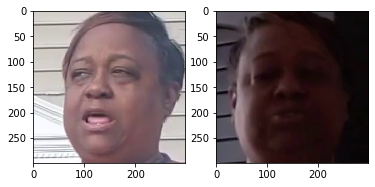

Fold leaks in cluster 212. Example: nlsqkoisdk.mp4 is in 0 and ekmjbxovtj.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 213. wbufbnhbgo.mp4 is in 1st_level and xjuudjewce.mp4 is in 2nd_level


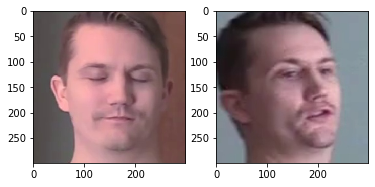

!!! 4 TRAIN-VAL LEAK(s) in cluster 214. rquraijvma.mp4 is in 1st_level and sjyjyvwpbl.mp4 is in 2nd_level


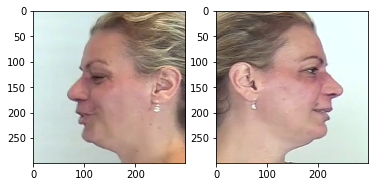

Fold leaks in cluster 214. Example: rquraijvma.mp4 is in 0 and sjyjyvwpbl.mp4 is in 2
Fold leaks in cluster 217. Example: rjzafaghui.mp4 is in 0 and xbtuqfmquq.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 218. laytvmltyd.mp4 is in 1st_level and xggxiunuhp.mp4 is in 2nd_level


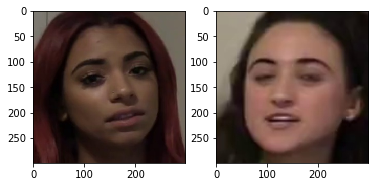

Fold leaks in cluster 218. Example: rkfzwbhqry.mp4 is in 0 and xggxiunuhp.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 224. ftqkikwzkv.mp4 is in 1st_level and uogkikugah.mp4 is in 2nd_level


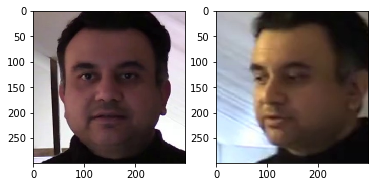

Fold leaks in cluster 224. Example: ftqkikwzkv.mp4 is in 1 and uogkikugah.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 225. satqlycwnv.mp4 is in 1st_level and addtbwjyjw.mp4 is in 2nd_level


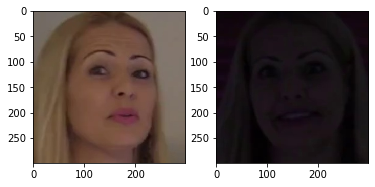

Fold leaks in cluster 225. Example: addtbwjyjw.mp4 is in 2 and satqlycwnv.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 226. lbnhgcywcd.mp4 is in 1st_level and mwoleudtoq.mp4 is in 2nd_level


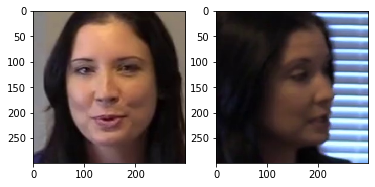

Fold leaks in cluster 226. Example: javcctidsr.mp4 is in 0 and lbnhgcywcd.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 227. juqplwkgxu.mp4 is in 1st_level and ubnxmiqwim.mp4 is in 2nd_level


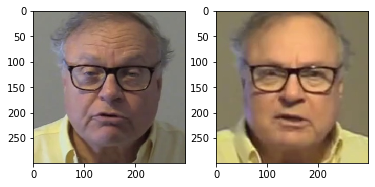

Fold leaks in cluster 227. Example: cxcsostsxq.mp4 is in 0 and ubnxmiqwim.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 230. ticjgcirbg.mp4 is in 1st_level and szkoxlypql.mp4 is in 2nd_level


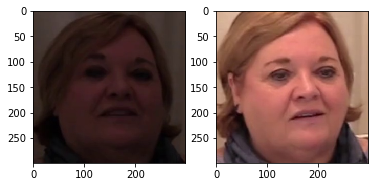

Fold leaks in cluster 230. Example: ticjgcirbg.mp4 is in 2 and szkoxlypql.mp4 is in 3
Fold leaks in cluster 231. Example: xjndyrsvfr.mp4 is in 2 and gppinocwlh.mp4 is in 3
!!! 7 TRAIN-VAL LEAK(s) in cluster 232. pfxaczizct.mp4 is in 1st_level and xtrdtctmuo.mp4 is in 2nd_level


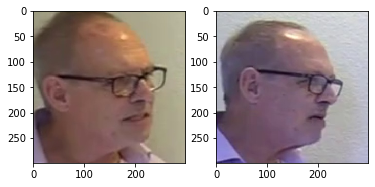

Fold leaks in cluster 232. Example: uievqldxgg.mp4 is in 2 and pfxaczizct.mp4 is in 3
Fold leaks in cluster 233. Example: gwvssgmgmh.mp4 is in 0 and gyrwjitwhy.mp4 is in 2
Fold leaks in cluster 235. Example: xugrceeldg.mp4 is in 1 and eayfrsvqsk.mp4 is in 2
Fold leaks in cluster 236. Example: chviwxsfhg.mp4 is in 1 and uuiaghtmqa.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 238. naevgucgiq.mp4 is in 1st_level and kkmbxyqbta.mp4 is in 2nd_level


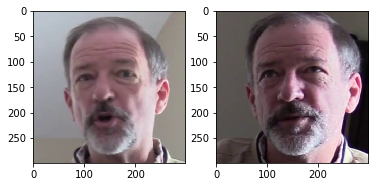

Fold leaks in cluster 238. Example: kkmbxyqbta.mp4 is in 2 and avcoxxzayv.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 239. snfjxqyrec.mp4 is in 1st_level and jhsdczgxic.mp4 is in 2nd_level


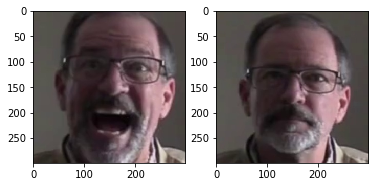

Fold leaks in cluster 239. Example: jhsdczgxic.mp4 is in 1 and snfjxqyrec.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 240. usmmpqmokb.mp4 is in 1st_level and furlafpbfx.mp4 is in 2nd_level


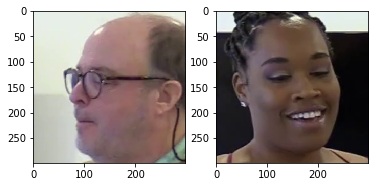

Fold leaks in cluster 240. Example: usmmpqmokb.mp4 is in 2 and furlafpbfx.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 241. exwjynivjo.mp4 is in 1st_level and ndyatztelp.mp4 is in 2nd_level


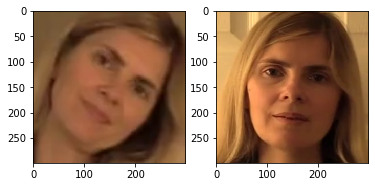

Fold leaks in cluster 242. Example: ggdicgpeis.mp4 is in 2 and yfnlrckeec.mp4 is in 4
!!! 8 TRAIN-VAL LEAK(s) in cluster 244. lgdusxgszd.mp4 is in 1st_level and znhmobdwnv.mp4 is in 2nd_level


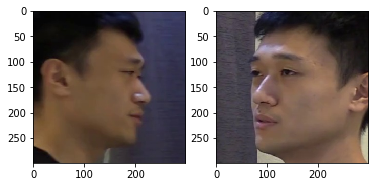

Fold leaks in cluster 244. Example: eykgzdbvpe.mp4 is in 1 and znhmobdwnv.mp4 is in 2
!!! 5 TRAIN-VAL LEAK(s) in cluster 245. ygdgwyqyut.mp4 is in 1st_level and lmlyvmfbbe.mp4 is in 2nd_level


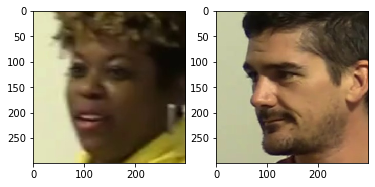

Fold leaks in cluster 245. Example: ygdgwyqyut.mp4 is in 0 and lmlyvmfbbe.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 246. caifxvsozs.mp4 is in 1st_level and xagsvjctmp.mp4 is in 2nd_level


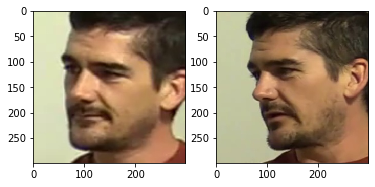

Fold leaks in cluster 246. Example: caifxvsozs.mp4 is in 0 and xagsvjctmp.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 247. gjypopglvi.mp4 is in 1st_level and dzyuwjkjui.mp4 is in 2nd_level


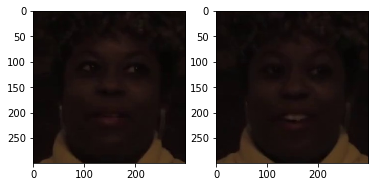

Fold leaks in cluster 248. Example: sqwvfgwdxr.mp4 is in 1 and tcwqbqyizt.mp4 is in 4
Fold leaks in cluster 249. Example: jljpdojupu.mp4 is in 1 and znpdbbsfvj.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 250. eqnoqyfquo.mp4 is in 1st_level and bejhvclboh.mp4 is in 2nd_level


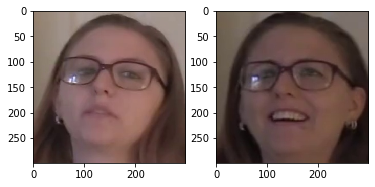

Fold leaks in cluster 250. Example: bejhvclboh.mp4 is in 0 and eqnoqyfquo.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 251. fntskqfxxf.mp4 is in 1st_level and woshnzbxmc.mp4 is in 2nd_level


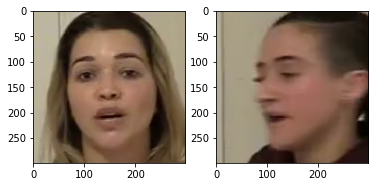

Fold leaks in cluster 251. Example: fntskqfxxf.mp4 is in 0 and woshnzbxmc.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 252. xgekquqhgh.mp4 is in 1st_level and ghpebcfeua.mp4 is in 2nd_level


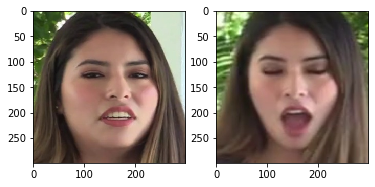

Fold leaks in cluster 252. Example: xgekquqhgh.mp4 is in 2 and ghpebcfeua.mp4 is in 3
!!! 4 TRAIN-VAL LEAK(s) in cluster 255. nlefohhkwi.mp4 is in 1st_level and qiuzeqtfjh.mp4 is in 2nd_level


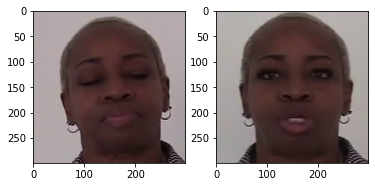

Fold leaks in cluster 255. Example: nlefohhkwi.mp4 is in 1 and ghdjltrbdf.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 256. gxdwfjrkyn.mp4 is in 1st_level and oxokstotfw.mp4 is in 2nd_level


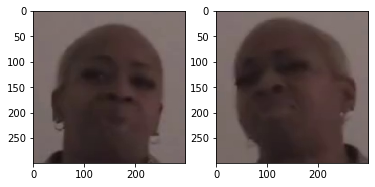

Fold leaks in cluster 256. Example: gxdwfjrkyn.mp4 is in 2 and oxokstotfw.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 257. vgngnciziy.mp4 is in 1st_level and zyqrmwygjg.mp4 is in 2nd_level


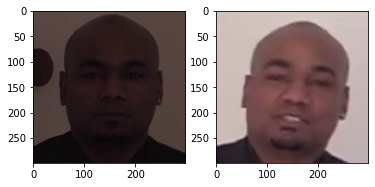

Fold leaks in cluster 257. Example: bykcwiczkr.mp4 is in 1 and zyqrmwygjg.mp4 is in 3
Fold leaks in cluster 258. Example: gknrewulox.mp4 is in 1 and fsnrdxtzde.mp4 is in 2
!!! 5 TRAIN-VAL LEAK(s) in cluster 259. nwqbjauaim.mp4 is in 1st_level and vqnocyqksq.mp4 is in 2nd_level


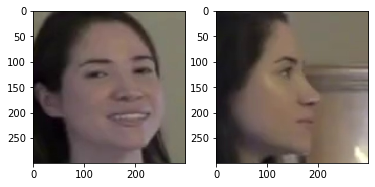

Fold leaks in cluster 259. Example: lgdmndcvee.mp4 is in 0 and nwqbjauaim.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 260. itnumzdchb.mp4 is in 1st_level and zoxvvvytkn.mp4 is in 2nd_level


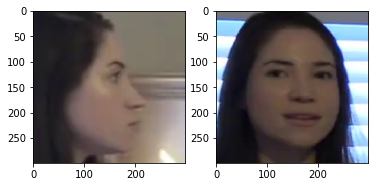

Fold leaks in cluster 260. Example: itnumzdchb.mp4 is in 0 and oiztpcrlqs.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 262. biotzvraxy.mp4 is in 1st_level and uzbjgegtje.mp4 is in 2nd_level


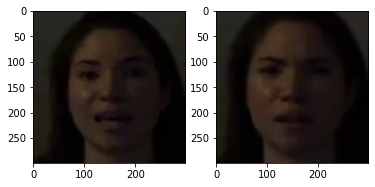

Fold leaks in cluster 262. Example: biotzvraxy.mp4 is in 0 and uzbjgegtje.mp4 is in 3
!!! 3 TRAIN-VAL LEAK(s) in cluster 263. bvndgybqfm.mp4 is in 1st_level and xfethgiiof.mp4 is in 2nd_level


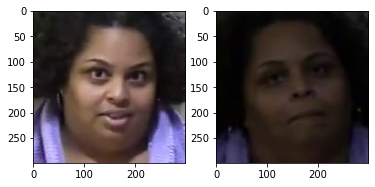

Fold leaks in cluster 263. Example: rixviasvaw.mp4 is in 0 and xfethgiiof.mp4 is in 1
Fold leaks in cluster 264. Example: wnwqudnwzo.mp4 is in 2 and jxhfgcyked.mp4 is in 3
!!! 3 TRAIN-VAL LEAK(s) in cluster 267. fzejmrhnzc.mp4 is in 1st_level and bxrqolkezc.mp4 is in 2nd_level


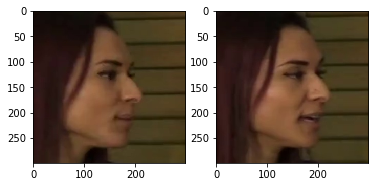

Fold leaks in cluster 267. Example: fzejmrhnzc.mp4 is in 2 and bxrqolkezc.mp4 is in 3
Fold leaks in cluster 268. Example: yceploelog.mp4 is in 2 and sdxejfublr.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 270. chdbnyxful.mp4 is in 1st_level and hkbkvhcynv.mp4 is in 2nd_level


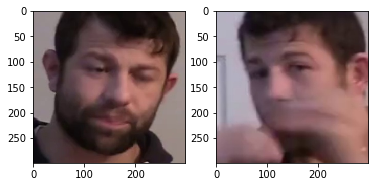

Fold leaks in cluster 270. Example: chdbnyxful.mp4 is in 3 and hkbkvhcynv.mp4 is in 4
Fold leaks in cluster 275. Example: xputpatbat.mp4 is in 3 and eveumzukvk.mp4 is in 4
!!! 2 TRAIN-VAL LEAK(s) in cluster 276. iqfisfoptm.mp4 is in 1st_level and nilziheylw.mp4 is in 2nd_level


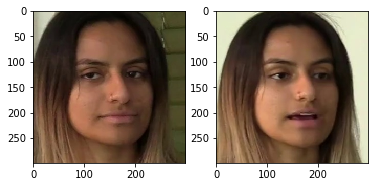

Fold leaks in cluster 276. Example: vwpsbjkjyc.mp4 is in 0 and nilziheylw.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 277. nroandyoda.mp4 is in 1st_level and vhrhkimkpw.mp4 is in 2nd_level


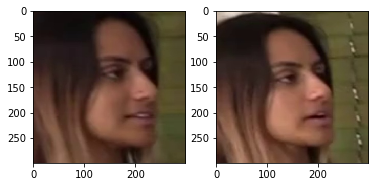

Fold leaks in cluster 277. Example: nroandyoda.mp4 is in 2 and ycsosobhoc.mp4 is in 4
Fold leaks in cluster 279. Example: fsmhgajswf.mp4 is in 1 and xdbhbekmyy.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 281. otrkmujlck.mp4 is in 1st_level and xsrrkijyqa.mp4 is in 2nd_level


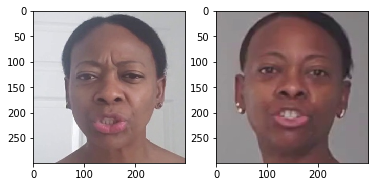

Fold leaks in cluster 281. Example: otrkmujlck.mp4 is in 0 and wqoihdhglu.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 282. fyfwsuzsge.mp4 is in 1st_level and zpgwhpjqaw.mp4 is in 2nd_level


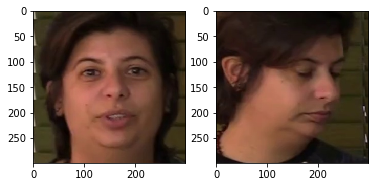

!!! 2 TRAIN-VAL LEAK(s) in cluster 284. uuynfvpdzz.mp4 is in 1st_level and frjllotrxj.mp4 is in 2nd_level


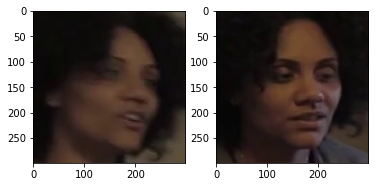

Fold leaks in cluster 284. Example: frjllotrxj.mp4 is in 0 and uuynfvpdzz.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 285. wcagdhcwxf.mp4 is in 1st_level and xckjlunrod.mp4 is in 2nd_level


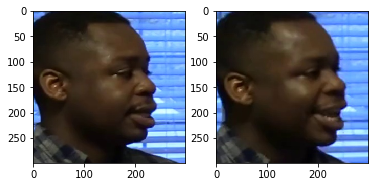

Fold leaks in cluster 285. Example: xckjlunrod.mp4 is in 0 and wcagdhcwxf.mp4 is in 1
Fold leaks in cluster 286. Example: mgaactvljt.mp4 is in 1 and ievfrmztyv.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 288. qvyghudsuq.mp4 is in 1st_level and ppwypsxgef.mp4 is in 2nd_level


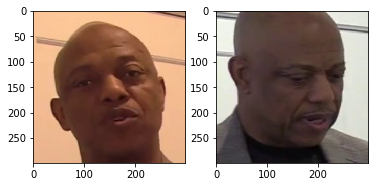

!!! 1 TRAIN-VAL LEAK(s) in cluster 289. phctsyvszl.mp4 is in 1st_level and gdlmljpqio.mp4 is in 2nd_level


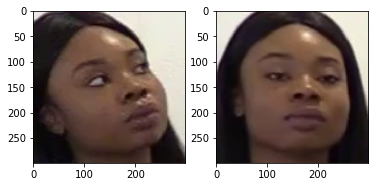

Fold leaks in cluster 289. Example: gdlmljpqio.mp4 is in 1 and phctsyvszl.mp4 is in 4
Fold leaks in cluster 290. Example: hpyhoykdwo.mp4 is in 2 and ycgrwhoaqk.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 291. tqljyqrltf.mp4 is in 1st_level and sdqiwyciek.mp4 is in 2nd_level


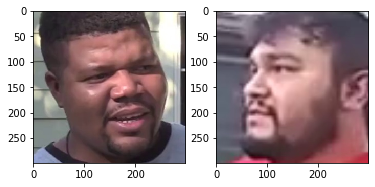

Fold leaks in cluster 291. Example: sdqiwyciek.mp4 is in 0 and tqljyqrltf.mp4 is in 3
Fold leaks in cluster 299. Example: upkzpbdlbj.mp4 is in 0 and diycjnntjf.mp4 is in 2
!!! 8 TRAIN-VAL LEAK(s) in cluster 300. mgwbjxpbxr.mp4 is in 1st_level and cbtzxanzcj.mp4 is in 2nd_level


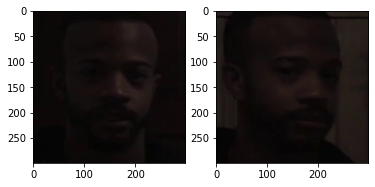

!!! 1 TRAIN-VAL LEAK(s) in cluster 301. qlgpprqvad.mp4 is in 1st_level and yuvzsrxurn.mp4 is in 2nd_level


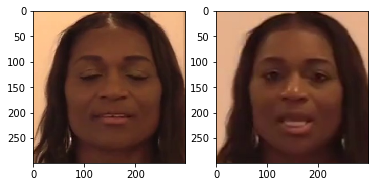

Fold leaks in cluster 301. Example: qlgpprqvad.mp4 is in 0 and yuvzsrxurn.mp4 is in 4
Fold leaks in cluster 304. Example: enneoqmjbk.mp4 is in 2 and hxcazozhqo.mp4 is in 3
Fold leaks in cluster 310. Example: bigruojxrp.mp4 is in 2 and ofgqjiclbm.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 311. hjqhxyndit.mp4 is in 1st_level and kimgtneysx.mp4 is in 2nd_level


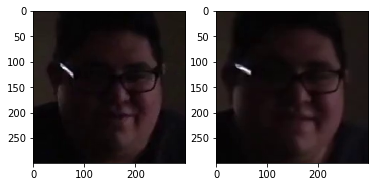

!!! 1 TRAIN-VAL LEAK(s) in cluster 313. eofloyspbg.mp4 is in 1st_level and kxjdoagdqj.mp4 is in 2nd_level


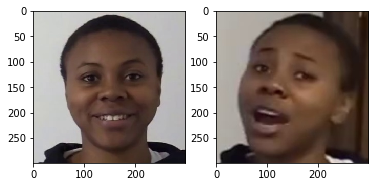

Fold leaks in cluster 313. Example: kxjdoagdqj.mp4 is in 1 and eofloyspbg.mp4 is in 3
Fold leaks in cluster 316. Example: vpjqndsnmf.mp4 is in 1 and dsfbtblodu.mp4 is in 4
!!! 4 TRAIN-VAL LEAK(s) in cluster 317. zixjeydihh.mp4 is in 1st_level and qorytsanvq.mp4 is in 2nd_level


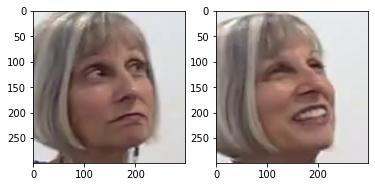

Fold leaks in cluster 317. Example: zixjeydihh.mp4 is in 1 and qorytsanvq.mp4 is in 3
!!! 6 TRAIN-VAL LEAK(s) in cluster 318. rcchrsnvtp.mp4 is in 1st_level and rfcsmhrgvs.mp4 is in 2nd_level


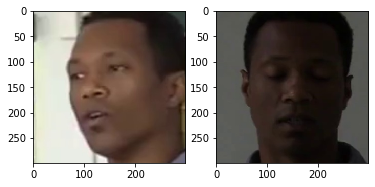

Fold leaks in cluster 318. Example: rcchrsnvtp.mp4 is in 0 and oovwjjxjmm.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 320. jvuwsnvypv.mp4 is in 1st_level and pejrnudjqj.mp4 is in 2nd_level


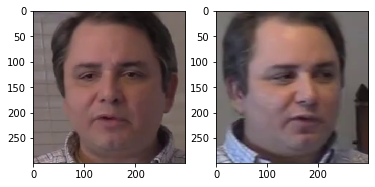

Fold leaks in cluster 320. Example: oklfahbqif.mp4 is in 2 and jvuwsnvypv.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 321. ncoxkqthhw.mp4 is in 1st_level and qmwpmtjkew.mp4 is in 2nd_level


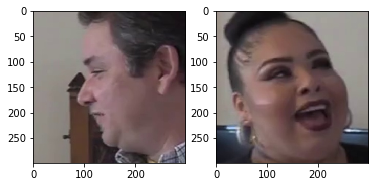

!!! 1 TRAIN-VAL LEAK(s) in cluster 322. bucsokxbxr.mp4 is in 1st_level and fyhjptbshw.mp4 is in 2nd_level


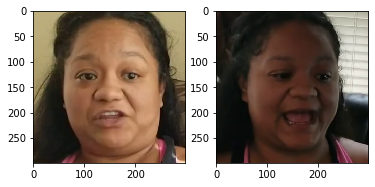

Fold leaks in cluster 322. Example: fyhjptbshw.mp4 is in 0 and bucsokxbxr.mp4 is in 1
!!! 3 TRAIN-VAL LEAK(s) in cluster 323. twqxiioazc.mp4 is in 1st_level and dnhijyqzac.mp4 is in 2nd_level


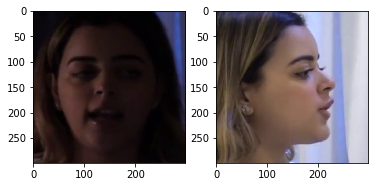

Fold leaks in cluster 323. Example: dnhijyqzac.mp4 is in 2 and ciigqisggi.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 330. vftavpyqby.mp4 is in 1st_level and yuzdamakoa.mp4 is in 2nd_level


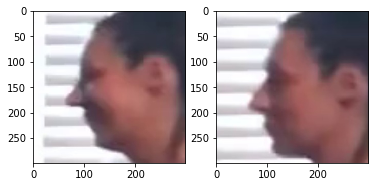

Fold leaks in cluster 334. Example: hlqvmahzco.mp4 is in 2 and vhcrrcszbc.mp4 is in 3
Fold leaks in cluster 335. Example: ykmpcxevug.mp4 is in 0 and wewmaulmxp.mp4 is in 3
Fold leaks in cluster 336. Example: xpdwqvnafq.mp4 is in 1 and nrzxgzsvyt.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 344. nqxkmokygc.mp4 is in 1st_level and uwzuaveowu.mp4 is in 2nd_level


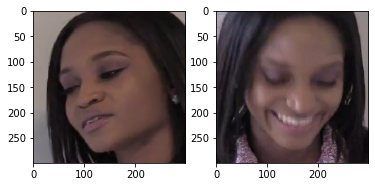

Fold leaks in cluster 344. Example: uwzuaveowu.mp4 is in 0 and nqxkmokygc.mp4 is in 2
Fold leaks in cluster 345. Example: lvrzbitwvw.mp4 is in 0 and wzogajzmev.mp4 is in 4
Fold leaks in cluster 347. Example: yvsnmunfal.mp4 is in 1 and swucolsqxc.mp4 is in 4
Fold leaks in cluster 348. Example: tzectnaqyj.mp4 is in 2 and ctfvpczuea.mp4 is in 4
!!! 3 TRAIN-VAL LEAK(s) in cluster 350. jyrnrfpdvl.mp4 is in 1st_level and ewpkflkuah.mp4 is in 2nd_level


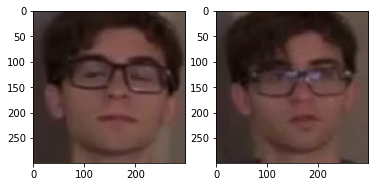

Fold leaks in cluster 350. Example: ewpkflkuah.mp4 is in 1 and jyrnrfpdvl.mp4 is in 2
Fold leaks in cluster 352. Example: xdodtqirhx.mp4 is in 0 and oibrdhopxr.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 353. ctibxwjesk.mp4 is in 1st_level and ltkvpexvao.mp4 is in 2nd_level


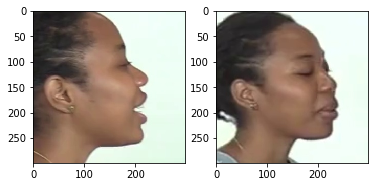

Fold leaks in cluster 353. Example: ltkvpexvao.mp4 is in 0 and ctibxwjesk.mp4 is in 2
Fold leaks in cluster 355. Example: tvmzuxpluu.mp4 is in 0 and xnljlvxxes.mp4 is in 4
!!! 2 TRAIN-VAL LEAK(s) in cluster 359. fsfjlwwsen.mp4 is in 1st_level and qcbbixyego.mp4 is in 2nd_level


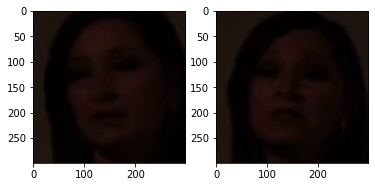

Fold leaks in cluster 359. Example: qcbbixyego.mp4 is in 2 and hgubfvlxta.mp4 is in 3
!!! 10 TRAIN-VAL LEAK(s) in cluster 360. azkdupbivt.mp4 is in 1st_level and vvzzgraotq.mp4 is in 2nd_level


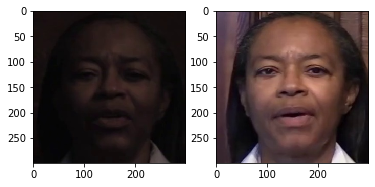

Fold leaks in cluster 360. Example: vvzzgraotq.mp4 is in 1 and azkdupbivt.mp4 is in 3
!!! 4 TRAIN-VAL LEAK(s) in cluster 361. whxkvxzupx.mp4 is in 1st_level and oqwfcxelxa.mp4 is in 2nd_level


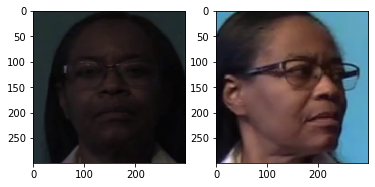

Fold leaks in cluster 361. Example: whxkvxzupx.mp4 is in 1 and ptfcnxqvob.mp4 is in 2
Fold leaks in cluster 363. Example: hbjiozieej.mp4 is in 3 and zhgrrcvxcw.mp4 is in 4
!!! 3 TRAIN-VAL LEAK(s) in cluster 364. maqgedtnrq.mp4 is in 1st_level and lkudcemyto.mp4 is in 2nd_level


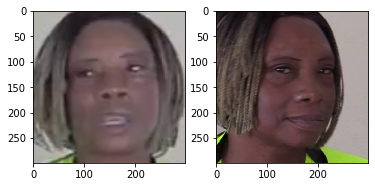

Fold leaks in cluster 364. Example: maqgedtnrq.mp4 is in 2 and lkudcemyto.mp4 is in 4
!!! 2 TRAIN-VAL LEAK(s) in cluster 365. cchbkkgxts.mp4 is in 1st_level and iqgfxqewgi.mp4 is in 2nd_level


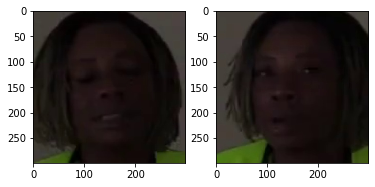

Fold leaks in cluster 367. Example: umqqxbaxoo.mp4 is in 1 and vxtfcgjagn.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 374. jdvwbbwqed.mp4 is in 1st_level and ygreqqihyy.mp4 is in 2nd_level


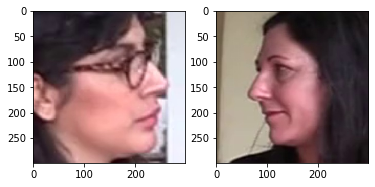

Fold leaks in cluster 374. Example: jdvwbbwqed.mp4 is in 2 and pjtwokcuhv.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 375. oxsmxlvbzo.mp4 is in 1st_level and wmaqobhmlu.mp4 is in 2nd_level


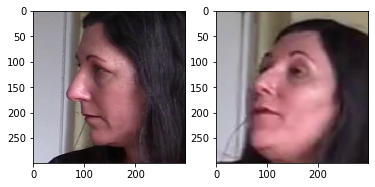

Fold leaks in cluster 375. Example: jlriwaayvn.mp4 is in 1 and oxsmxlvbzo.mp4 is in 2
Fold leaks in cluster 376. Example: fjgqrphojl.mp4 is in 1 and lgjmxefwpq.mp4 is in 4
Fold leaks in cluster 378. Example: dbsxlxitgm.mp4 is in 0 and cccwbhcnwe.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 379. kvuevajdzf.mp4 is in 1st_level and vwpeiuxppi.mp4 is in 2nd_level


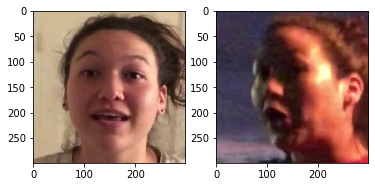

Fold leaks in cluster 379. Example: bwtuvbsgfa.mp4 is in 2 and kvuevajdzf.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 380. yqsdpjteec.mp4 is in 1st_level and ykgfznxxut.mp4 is in 2nd_level


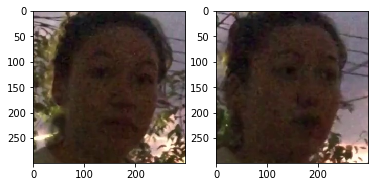

Fold leaks in cluster 380. Example: ngkrlyoazt.mp4 is in 1 and ykgfznxxut.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 383. fmfazqqfvk.mp4 is in 1st_level and psgcmeevqw.mp4 is in 2nd_level


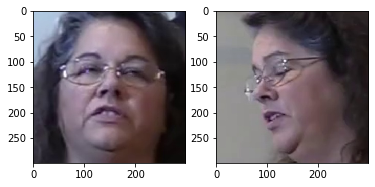

Fold leaks in cluster 383. Example: hdjvowbkbe.mp4 is in 2 and fmfazqqfvk.mp4 is in 3
Fold leaks in cluster 384. Example: hwsgjnslze.mp4 is in 1 and lpajeafiqi.mp4 is in 2
Fold leaks in cluster 385. Example: fmxawwhlub.mp4 is in 2 and ghyqfwpdsy.mp4 is in 4
!!! 6 TRAIN-VAL LEAK(s) in cluster 386. yiqdjbotyg.mp4 is in 1st_level and zyobeuzfji.mp4 is in 2nd_level


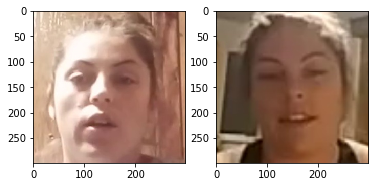

Fold leaks in cluster 386. Example: zyobeuzfji.mp4 is in 2 and rxdinxhihx.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 389. xacpmkqfec.mp4 is in 1st_level and ppjaaacxea.mp4 is in 2nd_level


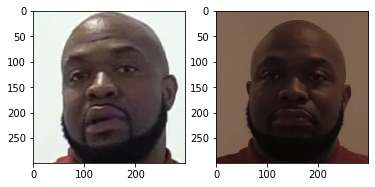

Fold leaks in cluster 389. Example: ppjaaacxea.mp4 is in 3 and xacpmkqfec.mp4 is in 4
Fold leaks in cluster 391. Example: kucoqzfsnh.mp4 is in 0 and aqzkiwfvlv.mp4 is in 4
!!! 3 TRAIN-VAL LEAK(s) in cluster 392. xfxsfmwrtw.mp4 is in 1st_level and glgtvkvauu.mp4 is in 2nd_level


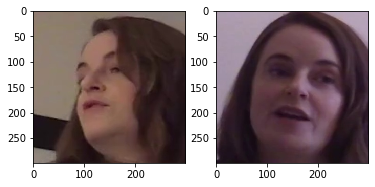

Fold leaks in cluster 392. Example: euegygpzez.mp4 is in 1 and ewuhuebngm.mp4 is in 2
Fold leaks in cluster 393. Example: qknolltspg.mp4 is in 1 and soegooiqam.mp4 is in 4
!!! 4 TRAIN-VAL LEAK(s) in cluster 395. etlroolqer.mp4 is in 1st_level and krcahkpiwj.mp4 is in 2nd_level


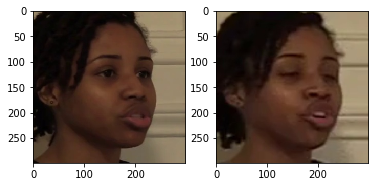

Fold leaks in cluster 395. Example: etlroolqer.mp4 is in 0 and cpmvsuixwn.mp4 is in 1
Fold leaks in cluster 396. Example: rhweihtjlk.mp4 is in 0 and reuyimrqxg.mp4 is in 1
Fold leaks in cluster 399. Example: gvlczlcpmq.mp4 is in 1 and bzkcxleaos.mp4 is in 2
!!! 5 TRAIN-VAL LEAK(s) in cluster 401. ymmjbgxugw.mp4 is in 1st_level and abzkauwmbl.mp4 is in 2nd_level


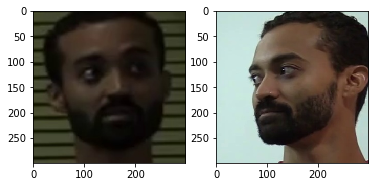

Fold leaks in cluster 401. Example: ymmjbgxugw.mp4 is in 3 and abzkauwmbl.mp4 is in 4
Fold leaks in cluster 404. Example: ixvkhbcuyq.mp4 is in 2 and azrovzeecz.mp4 is in 3
!!! 5 TRAIN-VAL LEAK(s) in cluster 405. mfhdprwfcs.mp4 is in 1st_level and bnfqcshwdx.mp4 is in 2nd_level


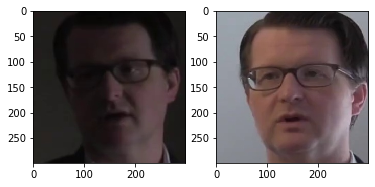

!!! 3 TRAIN-VAL LEAK(s) in cluster 406. pqmolaziou.mp4 is in 1st_level and tjtxivvbcq.mp4 is in 2nd_level


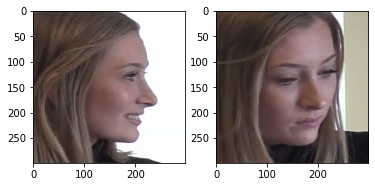

Fold leaks in cluster 406. Example: pqmolaziou.mp4 is in 1 and lawhopjppb.mp4 is in 2
Fold leaks in cluster 409. Example: korrsqtkke.mp4 is in 3 and dxepehnhgm.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 410. xbqmeyvujc.mp4 is in 1st_level and tucgexaclt.mp4 is in 2nd_level


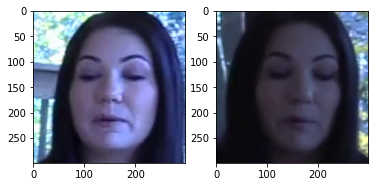

Fold leaks in cluster 410. Example: tucgexaclt.mp4 is in 1 and xbqmeyvujc.mp4 is in 4
!!! 2 TRAIN-VAL LEAK(s) in cluster 411. jxnutsjkxm.mp4 is in 1st_level and vujvqcnbol.mp4 is in 2nd_level


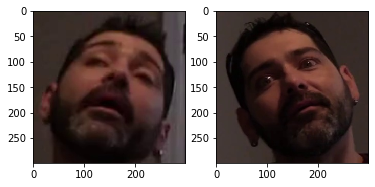

Fold leaks in cluster 411. Example: oswodkxhch.mp4 is in 2 and vujvqcnbol.mp4 is in 3
Fold leaks in cluster 413. Example: kypqqvwvvn.mp4 is in 0 and lagaytbhyh.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 415. bgbkogrfys.mp4 is in 1st_level and ffevfcjxva.mp4 is in 2nd_level


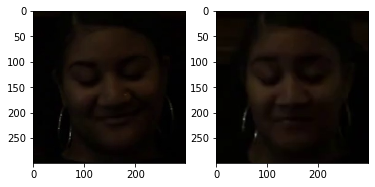

Fold leaks in cluster 415. Example: bgbkogrfys.mp4 is in 2 and ffevfcjxva.mp4 is in 3
!!! 15 TRAIN-VAL LEAK(s) in cluster 417. vrzcdynbco.mp4 is in 1st_level and oyafyvlxwx.mp4 is in 2nd_level


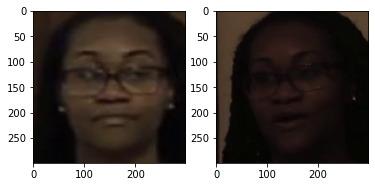

Fold leaks in cluster 417. Example: oyafyvlxwx.mp4 is in 2 and vrzcdynbco.mp4 is in 4
!!! 2 TRAIN-VAL LEAK(s) in cluster 420. voucpidonq.mp4 is in 1st_level and hzuyakazoo.mp4 is in 2nd_level


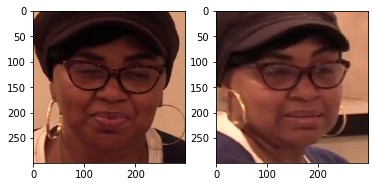

Fold leaks in cluster 420. Example: hzuyakazoo.mp4 is in 0 and plpkbnqpcv.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 421. orfsriylyy.mp4 is in 1st_level and jmvmztomdw.mp4 is in 2nd_level


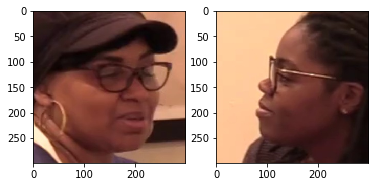

Fold leaks in cluster 421. Example: jmvmztomdw.mp4 is in 0 and orfsriylyy.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 422. zdhrbexqxz.mp4 is in 1st_level and rrdqahbwvb.mp4 is in 2nd_level


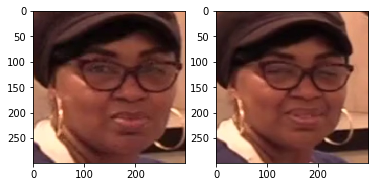

Fold leaks in cluster 422. Example: rrdqahbwvb.mp4 is in 0 and zdhrbexqxz.mp4 is in 4
!!! 3 TRAIN-VAL LEAK(s) in cluster 424. uomfimsutw.mp4 is in 1st_level and hhuakzfttr.mp4 is in 2nd_level


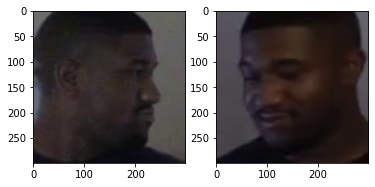

Fold leaks in cluster 424. Example: bpeemkcxad.mp4 is in 1 and uomfimsutw.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 430. zhftwvtutp.mp4 is in 1st_level and qjilklnynm.mp4 is in 2nd_level


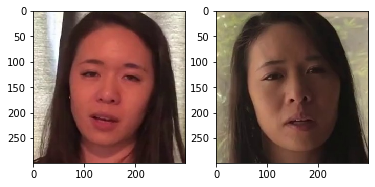

Fold leaks in cluster 431. Example: nlpvkvxgma.mp4 is in 0 and zwbjblztzx.mp4 is in 2
Fold leaks in cluster 434. Example: eswzqomvye.mp4 is in 1 and alzbizkswy.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 435. uuyyezfcnx.mp4 is in 1st_level and ibrdkgckhc.mp4 is in 2nd_level


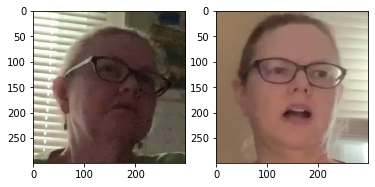

!!! 1 TRAIN-VAL LEAK(s) in cluster 436. lzzqbqakel.mp4 is in 1st_level and yvowabxoto.mp4 is in 2nd_level


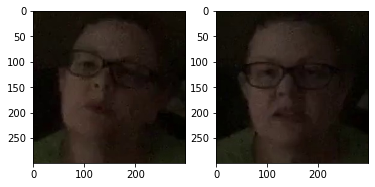

Fold leaks in cluster 436. Example: dgtdgrzifi.mp4 is in 2 and lzzqbqakel.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 438. qvgutokvct.mp4 is in 1st_level and xtixietgjp.mp4 is in 2nd_level


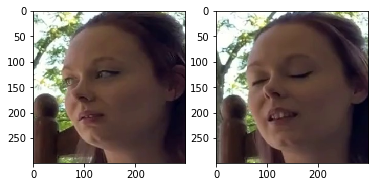

Fold leaks in cluster 438. Example: xtixietgjp.mp4 is in 3 and qvgutokvct.mp4 is in 4
!!! 2 TRAIN-VAL LEAK(s) in cluster 439. peqrlhqeuk.mp4 is in 1st_level and odmeoekpyu.mp4 is in 2nd_level


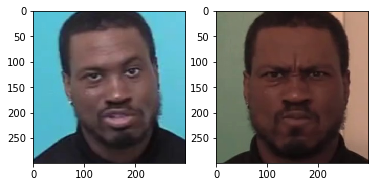

Fold leaks in cluster 439. Example: peqrlhqeuk.mp4 is in 3 and odmeoekpyu.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 442. julfellhdf.mp4 is in 1st_level and xhgsjkwadd.mp4 is in 2nd_level


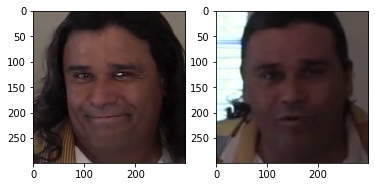

Fold leaks in cluster 442. Example: uvyxhwohay.mp4 is in 2 and xrugmaiubc.mp4 is in 3
Fold leaks in cluster 443. Example: uodarndzsb.mp4 is in 2 and gzvsihgvyu.mp4 is in 4
Fold leaks in cluster 449. Example: qfhmrgssju.mp4 is in 2 and uratvdiptg.mp4 is in 3
Fold leaks in cluster 450. Example: mkwhpzswmo.mp4 is in 2 and jwjyxtjdvp.mp4 is in 3
Fold leaks in cluster 452. Example: woewmsbgot.mp4 is in 2 and aszdwxqtnb.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 453. vwddtkosep.mp4 is in 1st_level and bkidieecdg.mp4 is in 2nd_level


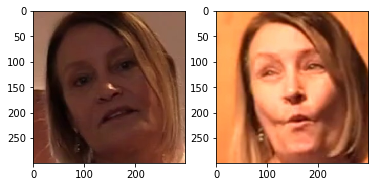

Fold leaks in cluster 453. Example: bkidieecdg.mp4 is in 0 and vwddtkosep.mp4 is in 4
Fold leaks in cluster 458. Example: duufrtgxtq.mp4 is in 0 and tbiyacqeew.mp4 is in 4
!!! 7 TRAIN-VAL LEAK(s) in cluster 459. kkpgyhdvmb.mp4 is in 1st_level and opqeorqknk.mp4 is in 2nd_level


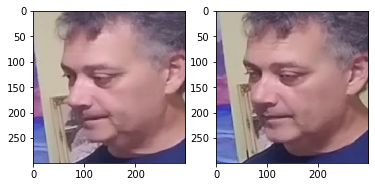

Fold leaks in cluster 459. Example: kkpgyhdvmb.mp4 is in 2 and opqeorqknk.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 463. kpltzztlvj.mp4 is in 1st_level and xgscdzbugy.mp4 is in 2nd_level


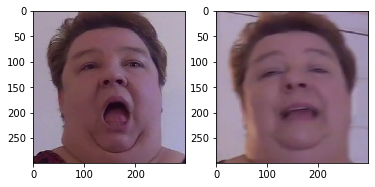

!!! 1 TRAIN-VAL LEAK(s) in cluster 464. ppmamjdpzw.mp4 is in 1st_level and dobyrqmayi.mp4 is in 2nd_level


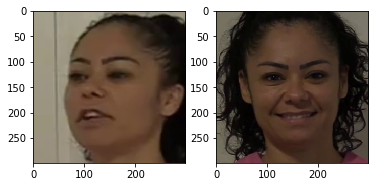

Fold leaks in cluster 464. Example: ppmamjdpzw.mp4 is in 2 and dobyrqmayi.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 466. wuhxicjmkj.mp4 is in 1st_level and bwavwszqqa.mp4 is in 2nd_level


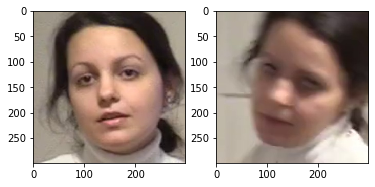

Fold leaks in cluster 467. Example: lsjvxakidz.mp4 is in 0 and zdhmhvkvqf.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 479. gcoeniltbg.mp4 is in 1st_level and nizarkvxtd.mp4 is in 2nd_level


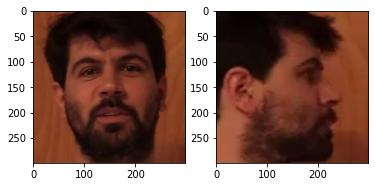

Fold leaks in cluster 479. Example: rffttupbkx.mp4 is in 0 and gcoeniltbg.mp4 is in 1
!!! 8 TRAIN-VAL LEAK(s) in cluster 483. klrpymmlkn.mp4 is in 1st_level and oitlkdosie.mp4 is in 2nd_level


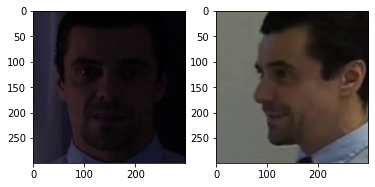

Fold leaks in cluster 483. Example: oitlkdosie.mp4 is in 1 and klrpymmlkn.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 487. egfspresvk.mp4 is in 1st_level and zvjpsvawqe.mp4 is in 2nd_level


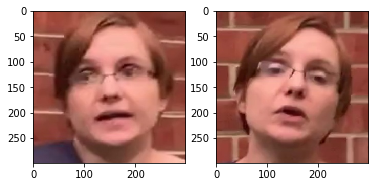

Fold leaks in cluster 487. Example: zvjpsvawqe.mp4 is in 0 and egfspresvk.mp4 is in 3
Fold leaks in cluster 488. Example: tpqdixzqqk.mp4 is in 0 and yicbshfjvy.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 489. kywkcmgtuh.mp4 is in 1st_level and mceixcangb.mp4 is in 2nd_level


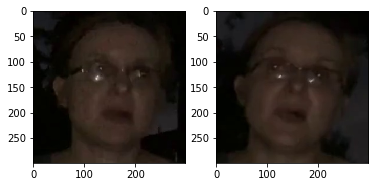

Fold leaks in cluster 489. Example: kywkcmgtuh.mp4 is in 0 and mceixcangb.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 493. vfdgfxvbaa.mp4 is in 1st_level and tsyhaasqip.mp4 is in 2nd_level


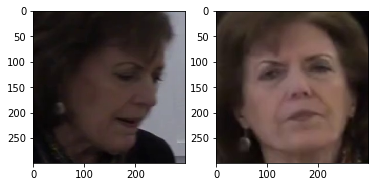

Fold leaks in cluster 493. Example: vfdgfxvbaa.mp4 is in 2 and tsyhaasqip.mp4 is in 3
Fold leaks in cluster 495. Example: ckesjfigst.mp4 is in 0 and eojtfnpgbb.mp4 is in 1
Fold leaks in cluster 496. Example: ncwrbwyubb.mp4 is in 3 and ntbkqlecod.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 500. fvfcrmjkrx.mp4 is in 1st_level and ccgmvconex.mp4 is in 2nd_level


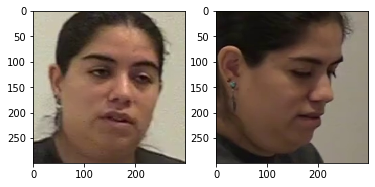

Fold leaks in cluster 500. Example: ccgmvconex.mp4 is in 2 and fvfcrmjkrx.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 503. aaragvjucp.mp4 is in 1st_level and rxilpbpeqt.mp4 is in 2nd_level


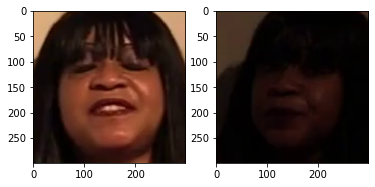

Fold leaks in cluster 505. Example: agxqtmywcf.mp4 is in 2 and hyfljfjzqc.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 506. ejfpanyjai.mp4 is in 1st_level and oubjhbhfiu.mp4 is in 2nd_level


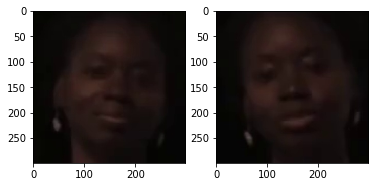

Fold leaks in cluster 506. Example: ejfpanyjai.mp4 is in 1 and oubjhbhfiu.mp4 is in 2
!!! 5 TRAIN-VAL LEAK(s) in cluster 507. thhgvxqnqv.mp4 is in 1st_level and aoabmfspkv.mp4 is in 2nd_level


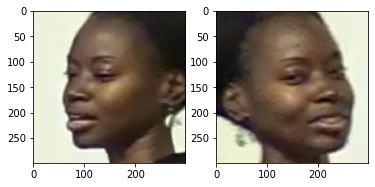

Fold leaks in cluster 507. Example: thhgvxqnqv.mp4 is in 1 and cceknmswyn.mp4 is in 2
Fold leaks in cluster 508. Example: wloxhpnucy.mp4 is in 1 and smwezpkhsn.mp4 is in 4
Fold leaks in cluster 511. Example: jclshaiflo.mp4 is in 1 and qqrfjzdcqt.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 514. kdwsdpqhna.mp4 is in 1st_level and jstxaddoee.mp4 is in 2nd_level


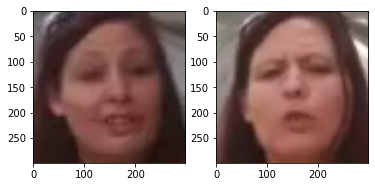

Fold leaks in cluster 514. Example: jstxaddoee.mp4 is in 2 and kdwsdpqhna.mp4 is in 3
!!! 8 TRAIN-VAL LEAK(s) in cluster 515. bamddalkqb.mp4 is in 1st_level and qptkhfnocw.mp4 is in 2nd_level


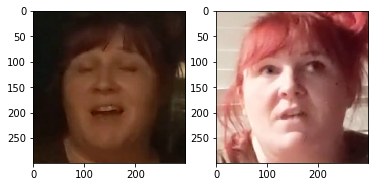

Fold leaks in cluster 515. Example: qptkhfnocw.mp4 is in 3 and bamddalkqb.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 518. wfjcilxofl.mp4 is in 1st_level and vdbmrmbyri.mp4 is in 2nd_level


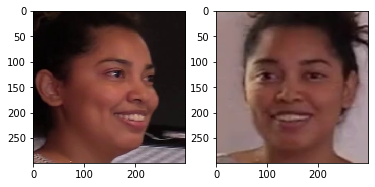

Fold leaks in cluster 518. Example: wfjcilxofl.mp4 is in 2 and vdbmrmbyri.mp4 is in 3
Fold leaks in cluster 520. Example: vivuivitho.mp4 is in 3 and wvtlbewjks.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 521. acguxjvmju.mp4 is in 1st_level and sjwklycfzv.mp4 is in 2nd_level


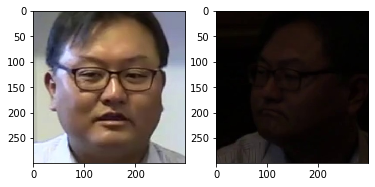

Fold leaks in cluster 521. Example: mpbddoyjda.mp4 is in 1 and sjwklycfzv.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 522. hxlrqvdokn.mp4 is in 1st_level and xsmgcxehef.mp4 is in 2nd_level


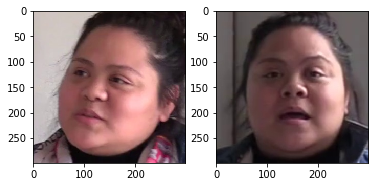

Fold leaks in cluster 522. Example: xsmgcxehef.mp4 is in 0 and yovjqxwytr.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 526. jpxgrnctcc.mp4 is in 1st_level and ttqenwctml.mp4 is in 2nd_level


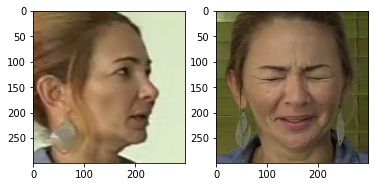

Fold leaks in cluster 526. Example: jpxgrnctcc.mp4 is in 2 and ttqenwctml.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 528. nxkmywcbwp.mp4 is in 1st_level and ovwolrwktu.mp4 is in 2nd_level


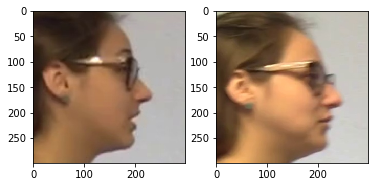

Fold leaks in cluster 528. Example: nxkmywcbwp.mp4 is in 2 and ovwolrwktu.mp4 is in 3
!!! 5 TRAIN-VAL LEAK(s) in cluster 529. zapcuremnl.mp4 is in 1st_level and avdwxsegib.mp4 is in 2nd_level


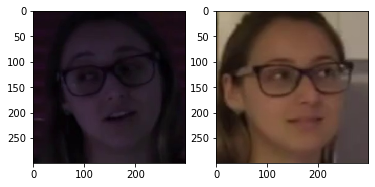

Fold leaks in cluster 529. Example: zapcuremnl.mp4 is in 1 and avdwxsegib.mp4 is in 3
Fold leaks in cluster 531. Example: phvoigvham.mp4 is in 1 and wibskravnb.mp4 is in 2
Fold leaks in cluster 532. Example: gnykansqlk.mp4 is in 2 and cebjakkosg.mp4 is in 4
!!! 3 TRAIN-VAL LEAK(s) in cluster 540. ezkjedjlcf.mp4 is in 1st_level and nlkniiykwh.mp4 is in 2nd_level


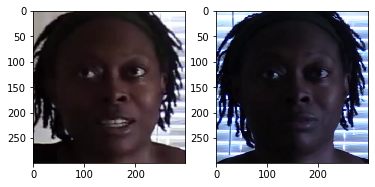

Fold leaks in cluster 540. Example: nlkniiykwh.mp4 is in 0 and osuurnhhie.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 541. szfrqkcljy.mp4 is in 1st_level and peezjbhcny.mp4 is in 2nd_level


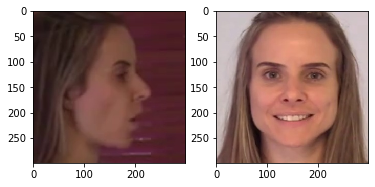

Fold leaks in cluster 541. Example: peezjbhcny.mp4 is in 0 and jqasusdlor.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 543. ughbtpdabx.mp4 is in 1st_level and xyvvgbdwde.mp4 is in 2nd_level


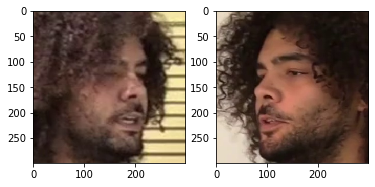

!!! 2 TRAIN-VAL LEAK(s) in cluster 545. vgswacpvls.mp4 is in 1st_level and fznubemmhy.mp4 is in 2nd_level


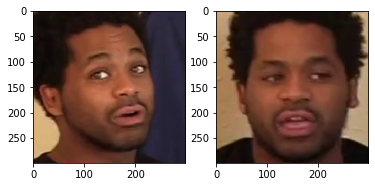

Fold leaks in cluster 547. Example: oyhiaxpwfa.mp4 is in 2 and knyplmogof.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 549. arkqrbjzld.mp4 is in 1st_level and qxvzfgsjou.mp4 is in 2nd_level


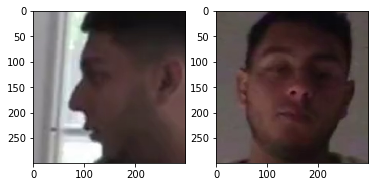

Fold leaks in cluster 549. Example: rhftkrhlzo.mp4 is in 1 and qxvzfgsjou.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 551. dfvnusznlr.mp4 is in 1st_level and zkhrbpkcmt.mp4 is in 2nd_level


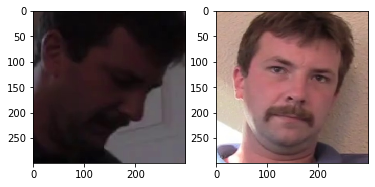

Fold leaks in cluster 551. Example: zkhrbpkcmt.mp4 is in 1 and dfvnusznlr.mp4 is in 2
Fold leaks in cluster 552. Example: karzkohlnx.mp4 is in 0 and jdoekxclgz.mp4 is in 3
Fold leaks in cluster 553. Example: mxkfkuzosk.mp4 is in 2 and mbfkiuzhpo.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 554. ihpewuxqzb.mp4 is in 1st_level and hubsbjmmwe.mp4 is in 2nd_level


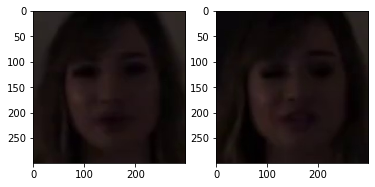

Fold leaks in cluster 554. Example: bgsokbksmw.mp4 is in 2 and ihpewuxqzb.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 555. sclhkvykgw.mp4 is in 1st_level and hjrksktoxs.mp4 is in 2nd_level


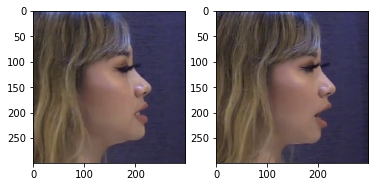

Fold leaks in cluster 556. Example: lqjechsnzg.mp4 is in 2 and ulkmrwykqx.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 561. tzickiqkiu.mp4 is in 1st_level and dkxgpxbuuy.mp4 is in 2nd_level


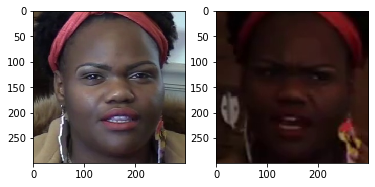

Fold leaks in cluster 561. Example: omgkxzclff.mp4 is in 0 and zkjotbhaqb.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 562. rourvegbvr.mp4 is in 1st_level and yltmjvmuln.mp4 is in 2nd_level


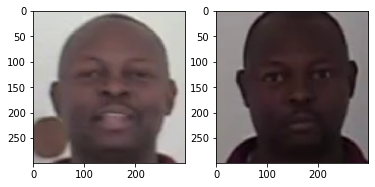

Fold leaks in cluster 562. Example: yltmjvmuln.mp4 is in 2 and rourvegbvr.mp4 is in 4
Fold leaks in cluster 565. Example: mquozjaiiw.mp4 is in 0 and cwzepohbwu.mp4 is in 2
Fold leaks in cluster 569. Example: hpoqxrddlx.mp4 is in 0 and uimkoyxrjp.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 570. fbqjyxiwgc.mp4 is in 1st_level and zsbkjqnbrt.mp4 is in 2nd_level


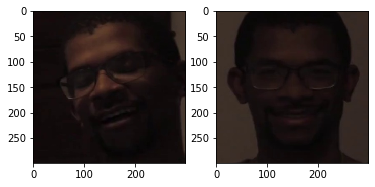

Fold leaks in cluster 570. Example: zsbkjqnbrt.mp4 is in 2 and refasbqxrh.mp4 is in 3
Fold leaks in cluster 572. Example: smptxlklxc.mp4 is in 2 and touinthtia.mp4 is in 3
!!! 10 TRAIN-VAL LEAK(s) in cluster 574. ohetfzyiao.mp4 is in 1st_level and liureznisp.mp4 is in 2nd_level


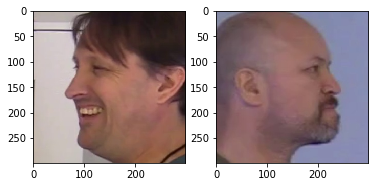

Fold leaks in cluster 574. Example: ohetfzyiao.mp4 is in 0 and sioiqldyvy.mp4 is in 1
!!! 1 TRAIN-VAL LEAK(s) in cluster 576. pilxjufslv.mp4 is in 1st_level and muwfbiuddn.mp4 is in 2nd_level


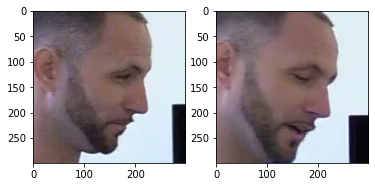

Fold leaks in cluster 576. Example: muwfbiuddn.mp4 is in 1 and qokisvxfsj.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 577. ziricwvglw.mp4 is in 1st_level and huontkxnwo.mp4 is in 2nd_level


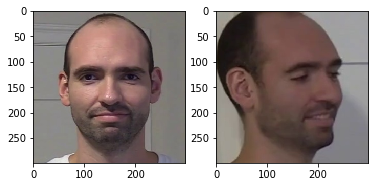

Fold leaks in cluster 577. Example: ziricwvglw.mp4 is in 0 and huontkxnwo.mp4 is in 2
Fold leaks in cluster 582. Example: gmhrvpxpus.mp4 is in 1 and hchpwjgudx.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 583. vvfmkgoyqd.mp4 is in 1st_level and pctljbtwvx.mp4 is in 2nd_level


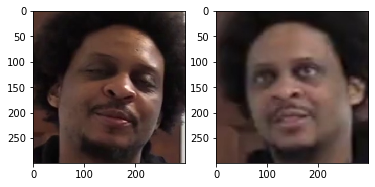

Fold leaks in cluster 583. Example: vvfmkgoyqd.mp4 is in 2 and eabyiybnkn.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 587. kugfpimhcx.mp4 is in 1st_level and zownomdhrp.mp4 is in 2nd_level


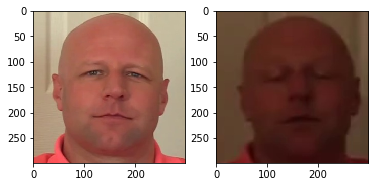

Fold leaks in cluster 587. Example: kugfpimhcx.mp4 is in 2 and gwgqpoaben.mp4 is in 3
!!! 1 TRAIN-VAL LEAK(s) in cluster 588. lthhnbvcyp.mp4 is in 1st_level and lfvvzweczk.mp4 is in 2nd_level


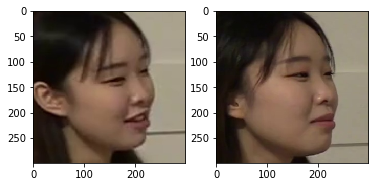

Fold leaks in cluster 588. Example: lthhnbvcyp.mp4 is in 2 and lfvvzweczk.mp4 is in 4
Fold leaks in cluster 589. Example: jqgiabjdum.mp4 is in 2 and zfrqdqczqc.mp4 is in 3
!!! 2 TRAIN-VAL LEAK(s) in cluster 591. govwgycgfx.mp4 is in 1st_level and fxsscbdili.mp4 is in 2nd_level


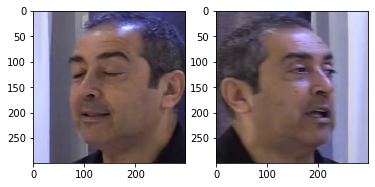

Fold leaks in cluster 591. Example: pdiozvcjlh.mp4 is in 2 and asezorxmhf.mp4 is in 3
!!! 7 TRAIN-VAL LEAK(s) in cluster 592. pipiskgjmf.mp4 is in 1st_level and weyytoiztb.mp4 is in 2nd_level


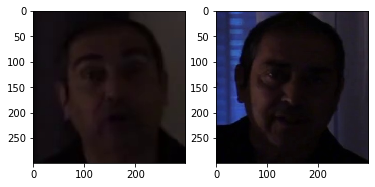

Fold leaks in cluster 592. Example: imicatmqrf.mp4 is in 1 and uowrnxnqyo.mp4 is in 2
!!! 1 TRAIN-VAL LEAK(s) in cluster 594. ivuvppfhap.mp4 is in 1st_level and damjizgilg.mp4 is in 2nd_level


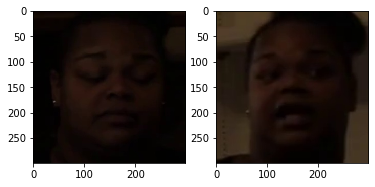

Fold leaks in cluster 594. Example: auilwijuvo.mp4 is in 1 and damjizgilg.mp4 is in 2
Fold leaks in cluster 600. Example: ocvainmgfr.mp4 is in 1 and zejayrbkts.mp4 is in 3
Fold leaks in cluster 603. Example: frbdbkxaim.mp4 is in 0 and uevxdeenvj.mp4 is in 2
Fold leaks in cluster 605. Example: oacylwoldp.mp4 is in 1 and wvvzfioonp.mp4 is in 4
!!! 2 TRAIN-VAL LEAK(s) in cluster 606. hwgvcwpzod.mp4 is in 1st_level and xbentgemej.mp4 is in 2nd_level


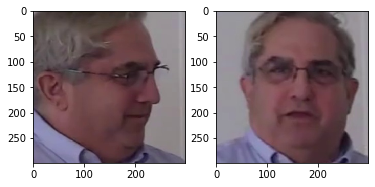

Fold leaks in cluster 606. Example: hwgvcwpzod.mp4 is in 1 and xbentgemej.mp4 is in 3
!!! 5 TRAIN-VAL LEAK(s) in cluster 611. ccpxfwqifj.mp4 is in 1st_level and ncrkggcdqp.mp4 is in 2nd_level


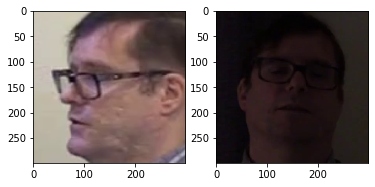

Fold leaks in cluster 611. Example: dwpurwnovd.mp4 is in 1 and ccpxfwqifj.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 613. zuekxdugku.mp4 is in 1st_level and cdhiogrmhb.mp4 is in 2nd_level


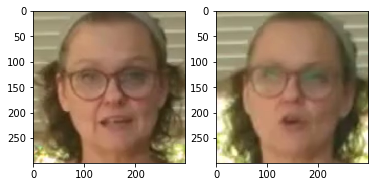

Fold leaks in cluster 613. Example: cdhiogrmhb.mp4 is in 1 and nwfhiittig.mp4 is in 2
!!! 11 TRAIN-VAL LEAK(s) in cluster 614. jniytngcmy.mp4 is in 1st_level and qavvoguryv.mp4 is in 2nd_level


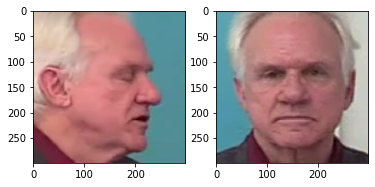

Fold leaks in cluster 614. Example: qavvoguryv.mp4 is in 2 and jniytngcmy.mp4 is in 4
Fold leaks in cluster 615. Example: hfcxlucrbj.mp4 is in 0 and aamjfukxwp.mp4 is in 3
!!! 4 TRAIN-VAL LEAK(s) in cluster 616. gfrqcbyfzu.mp4 is in 1st_level and yrmuznkgts.mp4 is in 2nd_level


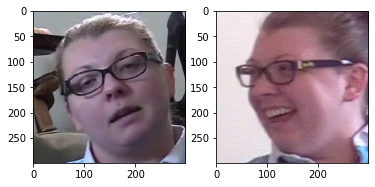

Fold leaks in cluster 616. Example: golysrbdyn.mp4 is in 0 and gfrqcbyfzu.mp4 is in 1
!!! 2 TRAIN-VAL LEAK(s) in cluster 617. pvsslamopo.mp4 is in 1st_level and hddminxrhw.mp4 is in 2nd_level


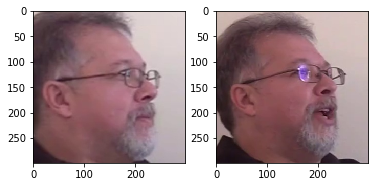

Fold leaks in cluster 617. Example: pvsslamopo.mp4 is in 1 and hddminxrhw.mp4 is in 2
!!! 5 TRAIN-VAL LEAK(s) in cluster 618. rqufsxbocb.mp4 is in 1st_level and lkvouattut.mp4 is in 2nd_level


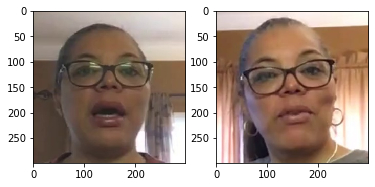

Fold leaks in cluster 618. Example: nggrodpfsn.mp4 is in 1 and lkvouattut.mp4 is in 2
!!! 3 TRAIN-VAL LEAK(s) in cluster 619. umerhoubxw.mp4 is in 1st_level and gbnqiddbus.mp4 is in 2nd_level


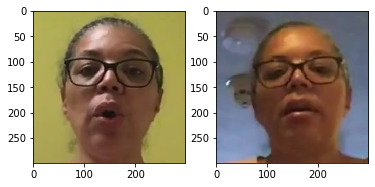

Fold leaks in cluster 619. Example: dbjeddgjgs.mp4 is in 1 and umerhoubxw.mp4 is in 2
!!! 2 TRAIN-VAL LEAK(s) in cluster 621. dvieslcdff.mp4 is in 1st_level and wtnloygygs.mp4 is in 2nd_level


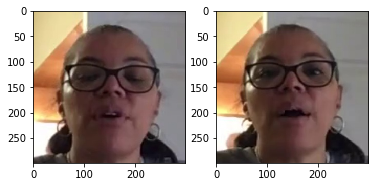

!!! 1 TRAIN-VAL LEAK(s) in cluster 623. pqjgyjlesf.mp4 is in 1st_level and epgfqrvwlr.mp4 is in 2nd_level


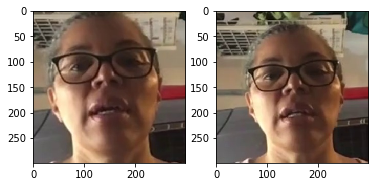

Fold leaks in cluster 623. Example: pqjgyjlesf.mp4 is in 2 and xwhzvvhkhw.mp4 is in 4
!!! 1 TRAIN-VAL LEAK(s) in cluster 624. ilzhgraxpl.mp4 is in 1st_level and wdpsjixfue.mp4 is in 2nd_level


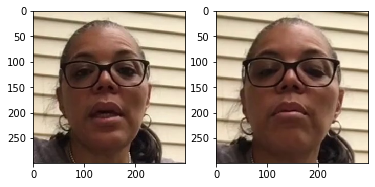

Fold leaks in cluster 626. Example: mdpyllcmrj.mp4 is in 2 and ubydbjxdmr.mp4 is in 4
Fold leaks in cluster 628. Example: uodwphygbp.mp4 is in 1 and ykfllpyawg.mp4 is in 2
Fold leaks in cluster 629. Example: dlmfukhdrj.mp4 is in 1 and kxqnvgrxqu.mp4 is in 3


In [23]:
for unique_cluster in unique_clusters:
    videofiles = df_clusters[df_clusters['cluster']==unique_cluster].video.values
    cluster_sample = df[df['index'].isin(videofiles)]
    
    # Check train val leak
    unique_splits = np.unique(cluster_sample.split.values)
    if unique_splits.shape[0] > 1:
        example_1 = cluster_sample[cluster_sample['split'] == unique_splits[0]]
        example_2 = cluster_sample[cluster_sample['split'] == unique_splits[1]]
        n_leaks = min(len(example_1),len(example_2))
        print('!!! {5} TRAIN-VAL LEAK(s) in cluster {0}. {1} is in {2} and {3} is in {4}'.format(unique_cluster,
                                                                                         example_1['index'].values[0],
                                                                                         example_1['split'].values[0],
                                                                                         example_2['index'].values[0],
                                                                                         example_2['split'].values[0],
                                                                                         n_leaks))
        img1_path = os.path.join(face_path,example_1['index'].values[0].replace('.mp4','_0_0.jpg'))
        img2_path = os.path.join(face_path,example_2['index'].values[0].replace('.mp4','_0_0.jpg'))
        f, ax = plt.subplots(1,2, figsize=(6,3))
        ax[0].imshow(cv2.cvtColor(cv2.imread(img1_path), cv2.COLOR_BGR2RGB))
        ax[1].imshow(cv2.cvtColor(cv2.imread(img2_path), cv2.COLOR_BGR2RGB))
        plt.show()
        plt.close()
        
        
    
    # Check fold leaks
    unique_folds = np.unique(cluster_sample.cv_fold.values)
    if unique_folds.shape[0] > 1:
        example_1 = cluster_sample[cluster_sample['cv_fold'] == unique_folds[0]]
        example_2 = cluster_sample[cluster_sample['cv_fold'] == unique_folds[1]]
        print('Fold leaks in cluster {0}. Example: {1} is in {2} and {3} is in {4}'.format(unique_cluster,
                                                                                         example_1['index'].values[0],
                                                                                         example_1['cv_fold'].values[0],
                                                                                         example_2['index'].values[0],
                                                                                         example_2['cv_fold'].values[0]))
    